In [1]:
import os
import numpy as np 
import itertools
import matplotlib
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D 
from matplotlib.markers import MarkerStyle
from mpl_toolkits.axes_grid1 import make_axes_locatable 

In [2]:
from matplotlib import rc
rc('text', usetex=True)
rc('font', family='serif')
rc('font', serif='times')
rc('mathtext', default='sf')
rc("lines", markeredgewidth=1)
rc("lines", linewidth=1)
rc('axes', titlesize=24) #24
rc('axes', labelsize=24) #24
rc("axes", linewidth=1) #2)
rc('axes', labelpad=20) #24)
rc('xtick', labelsize=16)
rc('ytick', labelsize=16)
rc('legend', fontsize=16)
rc('ytick', right='True',direction= 'in')
rc('xtick', top='True',direction= 'in')
rc('xtick.major', pad=15) #8)
rc('ytick.major', pad=15) #8)
rc('xtick.major', size=12) #8)
rc('ytick.major', size=12) #8)
rc('xtick.minor', size=7) #8)
rc('ytick.minor', size=7) #8)
rc('figure', titlesize=27) #24)

def set_tick_sizes(ax, major, minor):
    for l in ax.get_xticklines() + ax.get_yticklines():
        l.set_markersize(major)
    for tick in ax.xaxis.get_minor_ticks() + ax.yaxis.get_minor_ticks():
        tick.tick1line.set_markersize(minor)
        tick.tick2line.set_markersize(minor)
    ax.xaxis.LABELPAD=10.
    ax.xaxis.OFFSETTEXTPAD=10.

## Injections

In [ ]:
mchirpratio, snrratio = [.5, 1., 2.], [.5, 1.]
delta_tc = [-.1, -.05, -.03, -.02, -.01, .01, .02, .03, .05, .1]

combinations = list(itertools.product(mchirpratio, snrratio, delta_tc))

data_a, data_b = [], []
mchirp_a, mchirp_b = np.zeros(len(combinations)), np.zeros(len(combinations))
eta_a, eta_b = np.zeros(len(combinations)), np.zeros(len(combinations))
eff_spin_a, eff_spin_b = np.zeros(len(combinations)), np.zeros(len(combinations))
delta_tc, snr_a, snr_b, snr_ratio = np.zeros(len(combinations)), np.zeros(len(combinations)), np.zeros(len(combinations)), np.zeros(len(combinations))

for i in range(len(combinations)):
    data_a.append(np.load('../../output/pe_population_3G/injections/SINGLES_A_{}_{}_{}.npy'.format(combinations[i][0], combinations[i][1], combinations[i][2]), allow_pickle=True).item())
    data_b.append(np.load('../../output/pe_population_3G/injections/SINGLES_B_{}_{}_{}.npy'.format(combinations[i][0], combinations[i][1], combinations[i][2]), allow_pickle=True).item())

    mchirp_a[i], mchirp_b[i] = np.power(data_a[i]['mass_1']*data_a[i]['mass_2'], (3/5))/np.power(data_a[i]['mass_1']+data_a[i]['mass_2'], (1/5)), np.power(data_b[i]['mass_1']*data_b[i]['mass_2'], (3/5))/np.power(data_b[i]['mass_1']+data_b[i]['mass_2'], (1/5))
    eta_a[i], eta_b[i] = (data_a[i]['mass_1']*data_a[i]['mass_2'])/np.power(data_a[i]['mass_1']+data_a[i]['mass_2'], 2), (data_b[i]['mass_1']*data_b[i]['mass_2'])/np.power(data_b[i]['mass_1']+data_b[i]['mass_2'], 2)
    eff_spin_a[i], eff_spin_b[i] = data_a[i]['a_1'], data_b[i]['a_1']

    delta_tc[i] = data_b[i]['geocent_time'] - data_a[i]['geocent_time']
    snr_a[i], snr_b[i] = data_a[i]['snr_det'], data_b[i]['snr_det']
    snr_ratio[i] = snr_b[i]/snr_a[i]

In [4]:
snr_a = 24 * np.ones(len(combinations))
snr_b = snr_ratio * snr_a

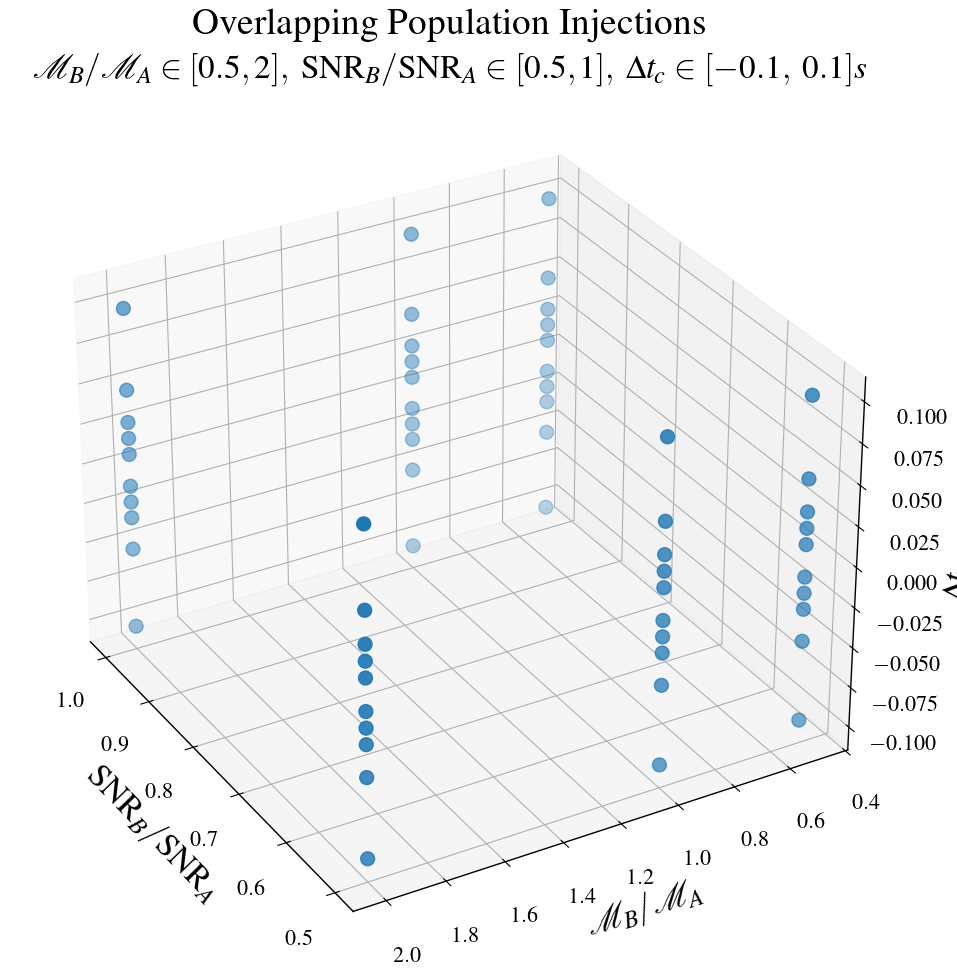

In [ ]:
fig, axes = plt.subplots(1, 1, figsize=(16, 10), subplot_kw={'projection': '3d'})
axes.scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, s=100)
axes.set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes.set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes.set_zlabel('$\Delta t_c$')
axes.ticklabel_format(useOffset=False, style='plain')
axes.set_title('$\\mathcal{M}_B/\\mathcal{M}_A\\in[0.5,2], \ \\mathrm{SNR}_B/\\mathrm{SNR}_A\\in[0.5,1], \ \\Delta t_c\\in[-0.1,\ 0.1]s$')
axes.azim = 150
plt.suptitle('Overlapping Population Injections')
plt.savefig('../../output/pe_population_3G/match/INJECTIONS.png')
plt.tight_layout()
plt.show()

## Microlensing Recovery

In [ ]:
match_ml, mchirp_ml, eta_ml, Ml_z_ml, y_ml = np.zeros(len(combinations)), np.zeros(len(combinations)), np.zeros(len(combinations)), np.zeros(len(combinations)), np.zeros(len(combinations))
for i in range(len(combinations)):
    try: 
        data_H1 = np.load('../../output/pe_population_3G/FF/FF_ML_4D_H1_{}_{}_{}.npy'.format(combinations[i][0], combinations[i][1], combinations[i][2]), allow_pickle=True)
        match_ml_H1, mchirp_ml_H1, eta_ml_H1, Ml_z_ml_H1, y_ml_H1 = data_H1[0], data_H1[1], data_H1[2], data_H1[3], data_H1[4]
        data_L1 = np.load('../../output/pe_population_3G/FF/FF_ML_4D_L1_{}_{}_{}.npy'.format(combinations[i][0], combinations[i][1], combinations[i][2]), allow_pickle=True)
        match_ml_L1, mchirp_ml_L1, eta_ml_L1, Ml_z_ml_L1, y_ml_L1 = data_L1[0], data_L1[1], data_L1[2], data_L1[3], data_L1[4]
        data_V1 = np.load('../../output/pe_population_3G/FF/FF_ML_4D_V1_{}_{}_{}.npy'.format(combinations[i][0], combinations[i][1], combinations[i][2]), allow_pickle=True)
        match_ml_V1, mchirp_ml_V1, eta_ml_V1, Ml_z_ml_V1, y_ml_V1 = data_V1[0], data_V1[1], data_V1[2], data_V1[3], data_V1[4]

        match_ml[i] = np.sqrt(np.mean([match_ml_H1**2, match_ml_L1**2, match_ml_V1**2]))
        if match_ml_H1 > match_ml_L1 and match_ml_H1 > match_ml_V1:
            mchirp_ml[i], eta_ml[i], Ml_z_ml[i], y_ml[i] = mchirp_ml_H1, eta_ml_H1, Ml_z_ml_H1, y_ml_H1
        elif match_ml_L1 > match_ml_H1 and match_ml_L1 > match_ml_V1:
            mchirp_ml[i], eta_ml[i], Ml_z_ml[i], y_ml[i] = mchirp_ml_L1, eta_ml_L1, Ml_z_ml_L1, y_ml_L1
        else:
            mchirp_ml[i], eta_ml[i], Ml_z_ml[i], y_ml[i] = mchirp_ml_V1, eta_ml_V1, Ml_z_ml_V1, y_ml_V1
    except:
        data = np.load('../../output/pe_population_3G/FF/FF_ML_4D_H1_{}_{}_{}.npy'.format(combinations[i][0], combinations[i][1], combinations[i][2]), allow_pickle=True)  
        match_ml[i], mchirp_ml[i], eta_ml[i], Ml_z_ml[i], y_ml[i] = data[0], data[1], data[2], data[3], data[4]

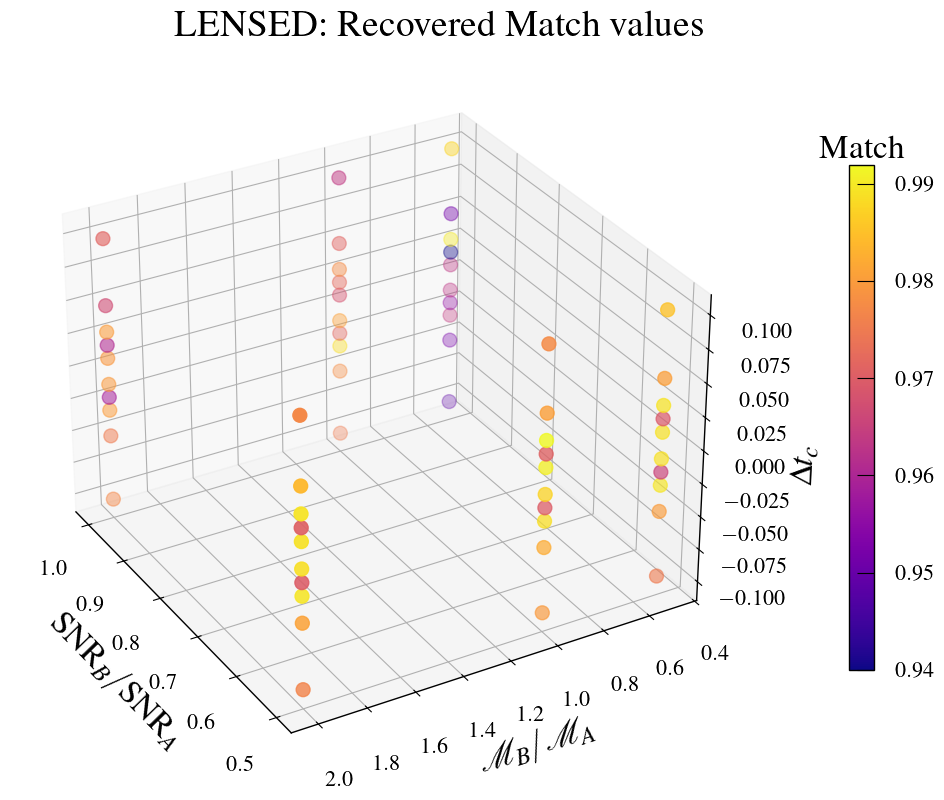

In [ ]:
fig, axes = plt.subplots(1, 1, figsize=(12, 8), subplot_kw={'projection': '3d'})

scatter = axes.scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=match_ml, edgecolor=None, cmap='plasma', s=100)
axes.set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes.set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes.set_zlabel('$\Delta t_c$')
axes.ticklabel_format(useOffset=False, style='plain')
axes.azim = 150

clb = fig.colorbar(scatter, ax=axes, shrink=0.7, pad=0.1)
clb.ax.set_title('Match')

plt.suptitle('LENSED: Recovered Match values')
plt.tight_layout()
plt.savefig('../../output/pe_population_3G/match/LENS_MATCH(3D).png')
plt.show()

### Chirp Mass $\mathcal{M}$ Bias

In [8]:
bias_mchirp_a_ml = np.abs(mchirp_ml-mchirp_a)/mchirp_a*100
bias_mchirp_b_ml = np.abs(mchirp_ml-mchirp_b)/mchirp_b*100

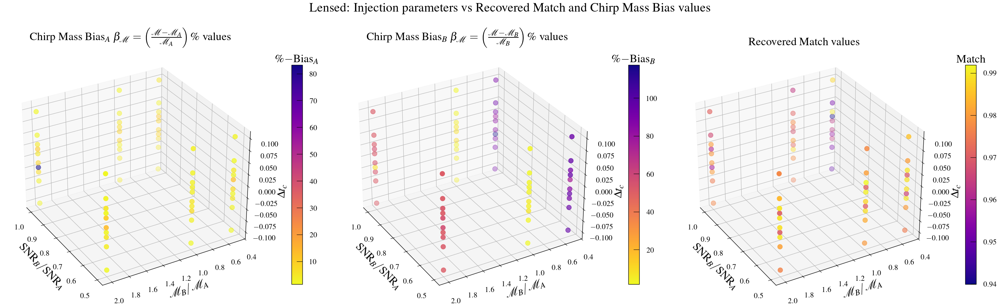

In [ ]:
fig, axes = plt.subplots(1, 3, figsize=(30, 10), subplot_kw={'projection': '3d'})

scatter1 = axes[0].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=bias_mchirp_a_ml, edgecolor=None, cmap='plasma_r', s=100)
clb1 = fig.colorbar(scatter1, ax=axes[0], shrink=0.7, pad=0.1)
clb1.ax.set_title('$\\%-$Bias$_A$')
clb1.ax.ticklabel_format(useOffset=False, style='plain')

axes[0].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[0].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[0].set_zlabel('$\Delta t_c$')
axes[0].set_title('Chirp Mass Bias$_A$ $\\beta_{\\mathcal{M}}=\\left(\\frac{\\mathcal{M}-\\mathcal{M}_A}{\\mathcal{M}_A}\\right)\\%$ values', loc='center')
axes[0].ticklabel_format(useOffset=False, style='plain')
axes[0].azim = 150

scatter2 = axes[1].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=bias_mchirp_b_ml, edgecolor=None, cmap='plasma_r', s=100)
clb2 = fig.colorbar(scatter2, ax=axes[1], shrink=0.7, pad=0.1)
clb2.ax.set_title('$\\%-$Bias$_B$')
clb2.ax.ticklabel_format(useOffset=False, style='plain')

axes[1].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[1].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[1].set_zlabel('$\Delta t_c$')
axes[1].set_title('Chirp Mass Bias$_B$ $\\beta_{\\mathcal{M}}=\\left(\\frac{\\mathcal{M}-\\mathcal{M}_B}{\\mathcal{M}_B}\\right)\\%$ values', loc='center')
axes[1].ticklabel_format(useOffset=False, style='plain')
axes[1].azim = 150

scatter3 = axes[2].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=match_ml, edgecolor=None, cmap='plasma', s=100)
clb3 = fig.colorbar(scatter3, ax=axes[2], shrink=0.7, pad=0.1)
clb3.ax.set_title('Match')
clb3.ax.ticklabel_format(useOffset=False, style='plain')

axes[2].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[2].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[2].set_zlabel('$\Delta t_c$')
axes[2].set_title('Recovered Match values', loc='center')
axes[2].ticklabel_format(useOffset=False, style='plain')
axes[2].azim = 150

fig.suptitle('Lensed: Injection parameters vs Recovered Match and Chirp Mass Bias values')
plt.tight_layout()
plt.savefig('../../output/pe_population_3G/match/LENS_BIAS_MCHIRP(3D).png')
plt.show()

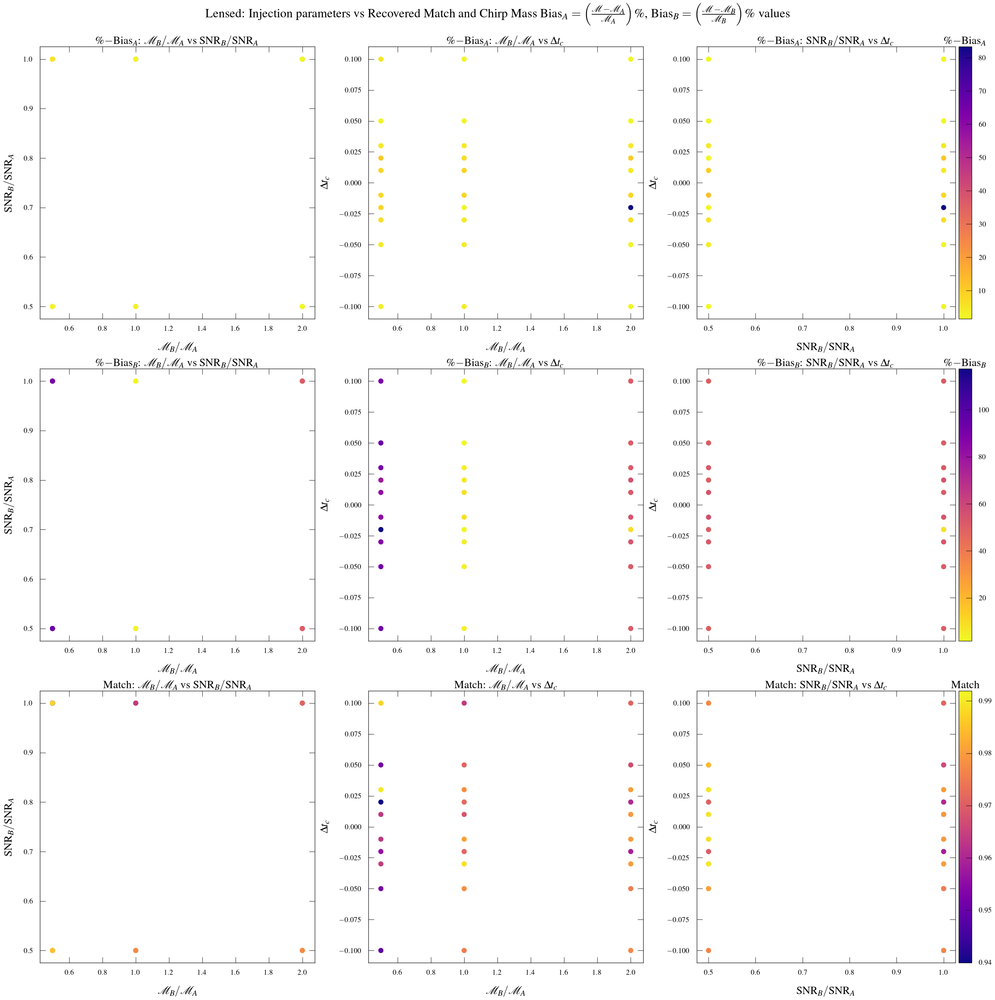

In [ ]:
fig, axes = plt.subplots(3, 3, figsize=(30, 30))

scatter11 = axes[0,0].scatter(mchirp_b/mchirp_a, snr_b/snr_a, c=bias_mchirp_a_ml, cmap='plasma_r',s=100)
axes[0,0].set_xlabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[0,0].set_ylabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[0,0].set_title('$\\%-$Bias$_A$: $\mathcal{M}_B/\mathcal{M}_A$ vs $\mathrm{SNR}_B/\mathrm{SNR}_A$')

scatter12 = axes[1,0].scatter(mchirp_b/mchirp_a, snr_b/snr_a, c=bias_mchirp_b_ml, cmap='plasma_r', s=100)
axes[1,0].set_xlabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[1,0].set_ylabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[1,0].set_title('$\\%-$Bias$_B$: $\mathcal{M}_B/\mathcal{M}_A$ vs $\mathrm{SNR}_B/\mathrm{SNR}_A$')

scatter13 = axes[2,0].scatter(mchirp_b/mchirp_a, snr_b/snr_a, c=match_ml, cmap='plasma', s=100)
axes[2,0].set_xlabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[2,0].set_ylabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[2,0].set_title('Match: $\mathcal{M}_B/\mathcal{M}_A$ vs $\mathrm{SNR}_B/\mathrm{SNR}_A$')

scatter21 = axes[0,1].scatter(mchirp_b/mchirp_a, delta_tc, c=bias_mchirp_a_ml, cmap='plasma_r', s=100)
axes[0,1].set_xlabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[0,1].set_ylabel('$\Delta t_c$')
axes[0,1].set_title('$\\%-$Bias$_A$: $\mathcal{M}_B/\mathcal{M}_A$ vs $\Delta t_c$')

scatter22 = axes[1,1].scatter(mchirp_b/mchirp_a, delta_tc, c=bias_mchirp_b_ml, cmap='plasma_r', s=100)
axes[1,1].set_xlabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[1,1].set_ylabel('$\Delta t_c$')
axes[1,1].set_title('$\\%-$Bias$_B$: $\mathcal{M}_B/\mathcal{M}_A$ vs $\Delta t_c$')

scatter32 = axes[2,1].scatter(mchirp_b/mchirp_a, delta_tc, c=match_ml, cmap='plasma', s=100)
axes[2,1].set_xlabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[2,1].set_ylabel('$\Delta t_c$')
axes[2,1].set_title('Match: $\mathcal{M}_B/\mathcal{M}_A$ vs $\Delta t_c$')

scatter31 = axes[0,2].scatter(snr_b/snr_a, delta_tc, c=bias_mchirp_a_ml, cmap='plasma_r', s=100)
divider = make_axes_locatable(axes[0, 2])
cax = divider.append_axes("right", size="5%", pad=0.1)
clb1 = plt.colorbar(scatter31, cax=cax)
clb1.ax.set_title('$\\%-$Bias$_A$')
clb1.ax.ticklabel_format(useOffset=False, style='plain')

axes[0,2].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[0,2].set_ylabel('$\Delta t_c$')
axes[0,2].set_title('$\\%-$Bias$_A$: $\mathrm{SNR}_B/\mathrm{SNR}_A$ vs $\Delta t_c$')

scatter32 = axes[1,2].scatter(snr_b/snr_a, delta_tc, c=bias_mchirp_b_ml, cmap='plasma_r', s=100)
divider = make_axes_locatable(axes[1, 2])
cax = divider.append_axes("right", size="5%", pad=0.1)
clb2 = plt.colorbar(scatter32, cax=cax)
clb2.ax.set_title('$\\%-$Bias$_B$')
clb2.ax.ticklabel_format(useOffset=False, style='plain')

axes[1,2].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[1,2].set_ylabel('$\Delta t_c$')
axes[1,2].set_title('$\\%-$Bias$_B$: $\mathrm{SNR}_B/\mathrm{SNR}_A$ vs $\Delta t_c$')

scatter33 = axes[2,2].scatter(snr_b/snr_a, delta_tc, c=match_ml, cmap='plasma', s=100)
divider = make_axes_locatable(axes[2, 2])
cax = divider.append_axes("right", size="5%", pad=0.1)
clb3 = plt.colorbar(scatter33, cax=cax)
clb3.ax.set_title('Match')
clb3.ax.ticklabel_format(useOffset=False, style='plain')

axes[2,2].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[2,2].set_ylabel('$\Delta t_c$')
axes[2,2].set_title('Match: $\mathrm{SNR}_B/\mathrm{SNR}_A$ vs $\Delta t_c$')

fig.suptitle('Lensed: Injection parameters vs Recovered Match and Chirp Mass Bias$_A$ $=\\left(\\frac{\\mathcal{M}-\\mathcal{M}_A}{\\mathcal{M}_A}\\right)\\%$, Bias$_B$ $=\\left(\\frac{\\mathcal{M}-\\mathcal{M}_B}{\\mathcal{M}_B}\\right)\\%$ values', y=1)
plt.tight_layout()
plt.savefig('../../output/pe_population_3G/match/LENS_BIAS_MCHIRP(2D).png')
plt.show()

### Microlensing Parameters: $\log_{10}{M_{\ell}^z}$, $y$

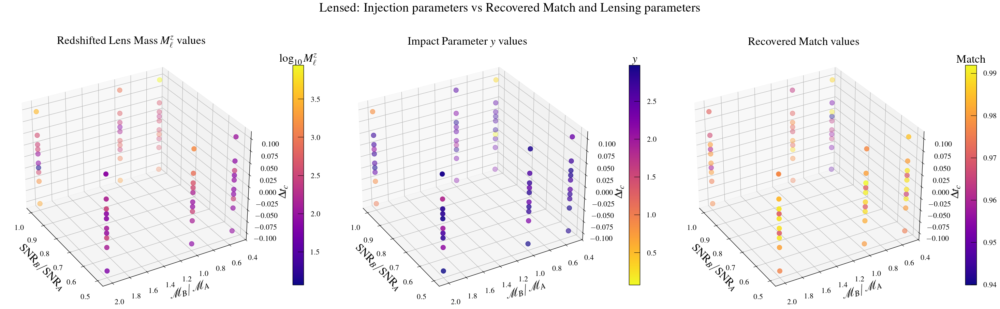

In [ ]:
fig, axes = plt.subplots(1, 3, figsize=(30, 10), subplot_kw={'projection': '3d'})

scatter1 = axes[0].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=np.log10(Ml_z_ml), edgecolor=None, cmap='plasma', s=100)
clb1 = fig.colorbar(scatter1, ax=axes[0], shrink=0.7, pad=0.1)
clb1.ax.set_title('$\\log_{10} M_{\ell}^z$')

axes[0].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[0].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[0].set_zlabel('$\Delta t_c$')
axes[0].set_title('Redshifted Lens Mass $M_{\ell}^z$ values', loc='center')
axes[0].ticklabel_format(useOffset=False, style='plain')
axes[0].azim = 150

scatter2 = axes[1].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=y_ml, edgecolor=None, cmap='plasma_r', s=100)
clb2 = fig.colorbar(scatter2, ax=axes[1], shrink=0.7, pad=0.1)
clb2.ax.set_title('$y$')

axes[1].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[1].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[1].set_zlabel('$\Delta t_c$')
axes[1].set_title('Impact Parameter $y$ values', loc='center')
axes[1].ticklabel_format(useOffset=False, style='plain')
axes[1].azim = 150

scatter3 = axes[2].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=match_ml, edgecolor=None, cmap='plasma', s=100)
clb3 = fig.colorbar(scatter3, ax=axes[2], shrink=0.7, pad=0.1)
clb3.ax.set_title('Match')

axes[2].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[2].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[2].set_zlabel('$\Delta t_c$')
axes[2].set_title('Recovered Match values', loc='center')
axes[2].ticklabel_format(useOffset=False, style='plain')
axes[2].azim = 150

fig.suptitle('Lensed: Injection parameters vs Recovered Match and Lensing parameters')
plt.tight_layout()
plt.savefig('../../output/pe_population_3G/match/LENS_PARAMS(3D).png')
plt.show()

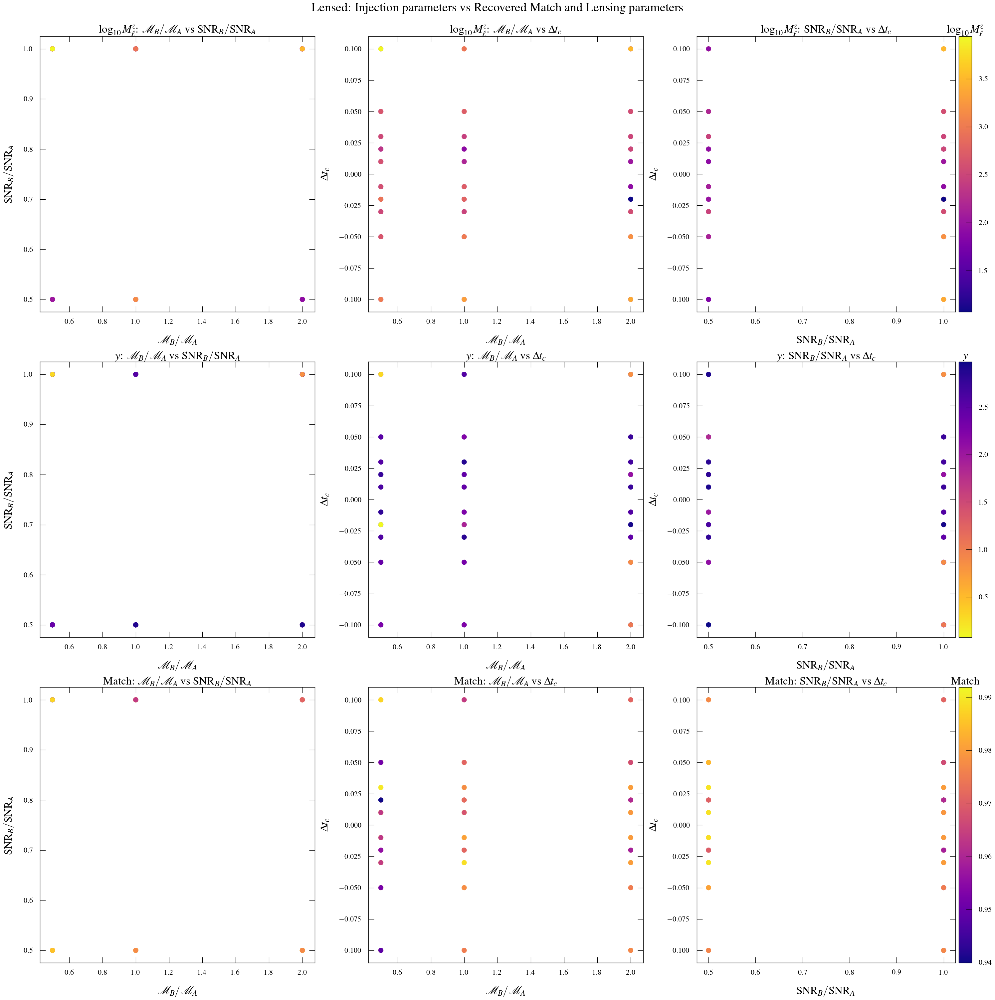

In [ ]:
fig, axes = plt.subplots(3, 3, figsize=(30, 30))

scatter11 = axes[0,0].scatter(mchirp_b/mchirp_a, snr_b/snr_a, c=np.log10(Ml_z_ml), cmap='plasma',s=100)
axes[0,0].set_xlabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[0,0].set_ylabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[0,0].set_title('$\\log_{10} M_{\ell}^z$: $\mathcal{M}_B/\mathcal{M}_A$ vs $\mathrm{SNR}_B/\mathrm{SNR}_A$')

scatter12 = axes[1,0].scatter(mchirp_b/mchirp_a, snr_b/snr_a, c=y_ml, cmap='plasma_r', s=100)
axes[1,0].set_xlabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[1,0].set_ylabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[1,0].set_title('$y$: $\mathcal{M}_B/\mathcal{M}_A$ vs $\mathrm{SNR}_B/\mathrm{SNR}_A$')

scatter13 = axes[2,0].scatter(mchirp_b/mchirp_a, snr_b/snr_a, c=match_ml, cmap='plasma', s=100)
axes[2,0].set_xlabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[2,0].set_ylabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[2,0].set_title('Match: $\mathcal{M}_B/\mathcal{M}_A$ vs $\mathrm{SNR}_B/\mathrm{SNR}_A$')

scatter21 = axes[0,1].scatter(mchirp_b/mchirp_a, delta_tc, c=np.log10(Ml_z_ml), cmap='plasma', s=100)
axes[0,1].set_xlabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[0,1].set_ylabel('$\Delta t_c$')
axes[0,1].set_title('$\\log_{10} M_{\ell}^z$: $\mathcal{M}_B/\mathcal{M}_A$ vs $\Delta t_c$')

scatter22 = axes[1,1].scatter(mchirp_b/mchirp_a, delta_tc, c=y_ml, cmap='plasma_r', s=100)
axes[1,1].set_xlabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[1,1].set_ylabel('$\Delta t_c$')
axes[1,1].set_title('$y$: $\mathcal{M}_B/\mathcal{M}_A$ vs $\Delta t_c$')

scatter32 = axes[2,1].scatter(mchirp_b/mchirp_a, delta_tc, c=match_ml, cmap='plasma', s=100)
axes[2,1].set_xlabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[2,1].set_ylabel('$\Delta t_c$')
axes[2,1].set_title('Match: $\mathcal{M}_B/\mathcal{M}_A$ vs $\Delta t_c$')

scatter31 = axes[0,2].scatter(snr_b/snr_a, delta_tc, c=np.log10(Ml_z_ml), cmap='plasma', s=100)
divider = make_axes_locatable(axes[0, 2])
cax = divider.append_axes("right", size="5%", pad=0.1)
clb1 = plt.colorbar(scatter31, cax=cax)
clb1.ax.set_title('$\\log_{10} M_{\ell}^z$')
axes[0,2].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[0,2].set_ylabel('$\Delta t_c$')
axes[0,2].set_title('$\\log_{10} M_{\ell}^z$: $\mathrm{SNR}_B/\mathrm{SNR}_A$ vs $\Delta t_c$')

scatter32 = axes[1,2].scatter(snr_b/snr_a, delta_tc, c=y_ml, cmap='plasma_r', s=100)
divider = make_axes_locatable(axes[1, 2])
cax = divider.append_axes("right", size="5%", pad=0.1)
clb2 = plt.colorbar(scatter32, cax=cax)
clb2.ax.set_title('$y$')
axes[1,2].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[1,2].set_ylabel('$\Delta t_c$')
axes[1,2].set_title('$y$: $\mathrm{SNR}_B/\mathrm{SNR}_A$ vs $\Delta t_c$')

scatter33 = axes[2,2].scatter(snr_b/snr_a, delta_tc, c=match_ml, cmap='plasma', s=100)
divider = make_axes_locatable(axes[2, 2])
cax = divider.append_axes("right", size="5%", pad=0.1)
clb3 = plt.colorbar(scatter33, cax=cax)
clb3.ax.set_title('Match')
axes[2,2].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[2,2].set_ylabel('$\Delta t_c$')
axes[2,2].set_title('Match: $\mathrm{SNR}_B/\mathrm{SNR}_A$ vs $\Delta t_c$')

fig.suptitle('Lensed: Injection parameters vs Recovered Match and Lensing parameters', y=1)
plt.tight_layout()
plt.savefig('../../output/pe_population_3G/match/LENS_PARAMS(2D).png')
plt.show()

## Type II Lensing Recovery 

In [ ]:
match_ml2, mchirp_ml2, eta_ml2 = np.zeros(len(combinations)), np.zeros(len(combinations)), np.zeros(len(combinations))
for i in range(len(combinations)):
    try:
        data_H1 = np.load('../../output/pe_population_3G/FF/FF_SL_2D_H1_{}_{}_{}.npy'.format(combinations[i][0], combinations[i][1], combinations[i][2]), allow_pickle=True)
        match_ml2_H1, mchirp_ml2_H1, eta_ml2_H1 = data_H1[0], data_H1[1], data_H1[2]
        data_L1 = np.load('../../output/pe_population_3G/FF/FF_SL_2D_L1_{}_{}_{}.npy'.format(combinations[i][0], combinations[i][1], combinations[i][2]), allow_pickle=True)
        match_ml2_L1, mchirp_ml2_L1, eta_ml2_L1 = data_L1[0], data_L1[1], data_L1[2]
        data_V1 = np.load('../../output/pe_population_3G/FF/FF_SL_2D_V1_{}_{}_{}.npy'.format(combinations[i][0], combinations[i][1], combinations[i][2]), allow_pickle=True)
        match_ml2_V1, mchirp_ml2_V1, eta_ml2_V1 = data_V1[0], data_V1[1], data_V1[2]
        
        match_ml2[i] = np.sqrt(np.mean([match_ml2_H1**2, match_ml2_L1**2, match_ml2_V1**2]))
        if match_ml2_H1 > match_ml2_L1 and match_ml2_H1 > match_ml2_V1:
            mchirp_ml2[i], eta_ml2[i] = mchirp_ml2_H1, eta_ml2_H1
        elif match_ml2_L1 > match_ml2_H1 and match_ml2_L1 > match_ml2_V1:
            mchirp_ml2[i], eta_ml2[i] = mchirp_ml2_L1, eta_ml2_L1
        else:
            mchirp_ml2[i], eta_ml2[i] = mchirp_ml2_V1, eta_ml
    except:
        data = np.load('../../output/pe_population_3G/FF/FF_SL_2D_H1_{}_{}_{}.npy'.format(combinations[i][0], combinations[i][1], combinations[i][2]), allow_pickle=True)
        match_ml2[i], mchirp_ml2[i], eta_ml2[i] = data[0], data[1], data[2]

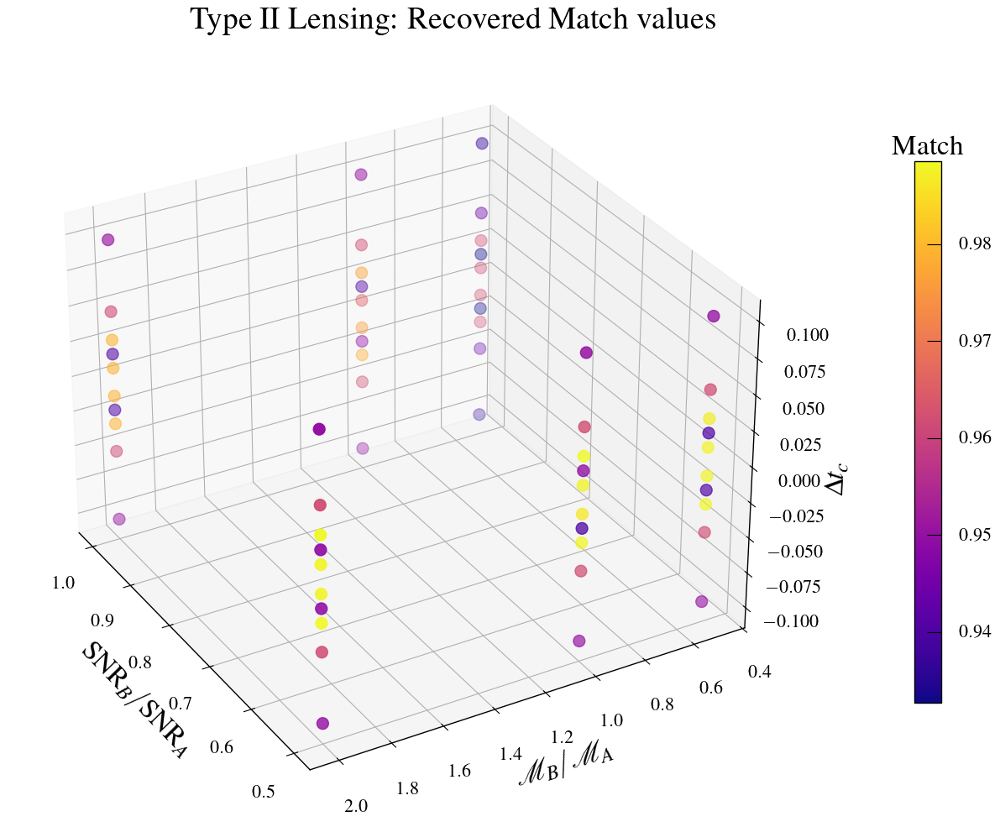

In [ ]:
fig, axes = plt.subplots(1, 1, figsize=(16, 10), subplot_kw={'projection': '3d'})

scatter = axes.scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=match_ml2, edgecolor=None, cmap='plasma', s=100)
axes.set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes.set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes.set_zlabel('$\Delta t_c$')
axes.ticklabel_format(useOffset=False, style='plain')
axes.azim = 150

clb = fig.colorbar(scatter, ax=axes, shrink=0.7, pad=0.1)
clb.ax.set_title('Match')

plt.suptitle('Type II Lensing: Recovered Match values')
plt.tight_layout()
plt.savefig('../../output/pe_population_3G/match/SL_MATCH(3D).png')
plt.show()

### Chirp Mass $\mathcal{M}$ Bias

In [15]:
bias_mchirp_a_ml2 = np.abs(mchirp_ml2-mchirp_a)/mchirp_a*100
bias_mchirp_b_ml2 = np.abs(mchirp_ml2-mchirp_b)/mchirp_b*100

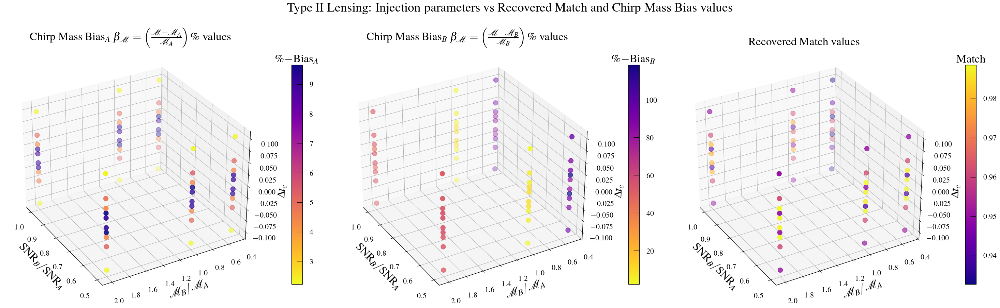

In [ ]:
fig, axes = plt.subplots(1, 3, figsize=(30, 10), subplot_kw={'projection': '3d'})

scatter1 = axes[0].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=bias_mchirp_a_ml2, edgecolor=None, cmap='plasma_r', s=100)
clb1 = fig.colorbar(scatter1, ax=axes[0], shrink=0.7, pad=0.1)
clb1.ax.set_title('$\\%-$Bias$_A$')
clb1.ax.ticklabel_format(useOffset=False, style='plain')

axes[0].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[0].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[0].set_zlabel('$\Delta t_c$')
axes[0].set_title('Chirp Mass Bias$_A$ $\\beta_{\\mathcal{M}}=\\left(\\frac{\\mathcal{M}-\\mathcal{M}_A}{\\mathcal{M}_A}\\right)\\%$ values', loc='center')
axes[0].ticklabel_format(useOffset=False, style='plain')
axes[0].azim = 150

scatter2 = axes[1].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=bias_mchirp_b_ml2, edgecolor=None, cmap='plasma_r', s=100)
clb2 = fig.colorbar(scatter2, ax=axes[1], shrink=0.7, pad=0.1)
clb2.ax.set_title('$\\%-$Bias$_B$')
clb2.ax.ticklabel_format(useOffset=False, style='plain')

axes[1].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[1].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[1].set_zlabel('$\Delta t_c$')
axes[1].set_title('Chirp Mass Bias$_B$ $\\beta_{\\mathcal{M}}=\\left(\\frac{\\mathcal{M}-\\mathcal{M}_B}{\\mathcal{M}_B}\\right)\\%$ values', loc='center')
axes[1].ticklabel_format(useOffset=False, style='plain')
axes[1].azim = 150

scatter3 = axes[2].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=match_ml2, edgecolor=None, cmap='plasma', s=100)
clb3 = fig.colorbar(scatter3, ax=axes[2], shrink=0.7, pad=0.1)
clb3.ax.set_title('Match')
clb3.ax.ticklabel_format(useOffset=False, style='plain')

axes[2].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[2].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[2].set_zlabel('$\Delta t_c$')
axes[2].set_title('Recovered Match values', loc='center')
axes[2].ticklabel_format(useOffset=False, style='plain')
axes[2].azim = 150

fig.suptitle('Type II Lensing: Injection parameters vs Recovered Match and Chirp Mass Bias values')
plt.tight_layout()
plt.savefig('../../output/pe_population_3G/match/SL_BIAS_MCHIRP(3D).png')
plt.show()

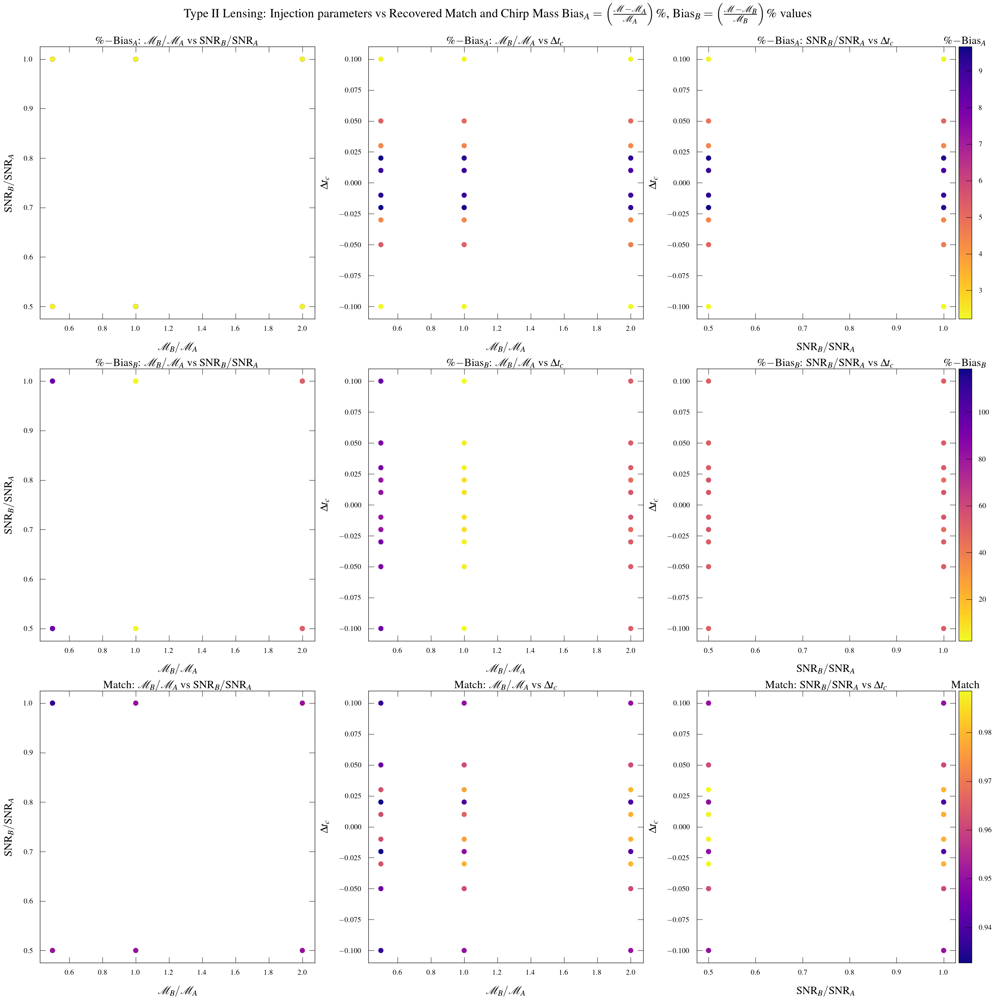

In [ ]:
fig, axes = plt.subplots(3, 3, figsize=(30, 30))

scatter11 = axes[0,0].scatter(mchirp_b/mchirp_a, snr_b/snr_a, c=bias_mchirp_a_ml2, cmap='plasma_r',s=100)
axes[0,0].set_xlabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[0,0].set_ylabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[0,0].set_title('$\\%-$Bias$_A$: $\mathcal{M}_B/\mathcal{M}_A$ vs $\mathrm{SNR}_B/\mathrm{SNR}_A$')

scatter12 = axes[1,0].scatter(mchirp_b/mchirp_a, snr_b/snr_a, c=bias_mchirp_b_ml2, cmap='plasma_r', s=100)
axes[1,0].set_xlabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[1,0].set_ylabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[1,0].set_title('$\\%-$Bias$_B$: $\mathcal{M}_B/\mathcal{M}_A$ vs $\mathrm{SNR}_B/\mathrm{SNR}_A$')

scatter13 = axes[2,0].scatter(mchirp_b/mchirp_a, snr_b/snr_a, c=match_ml2, cmap='plasma', s=100)
axes[2,0].set_xlabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[2,0].set_ylabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[2,0].set_title('Match: $\mathcal{M}_B/\mathcal{M}_A$ vs $\mathrm{SNR}_B/\mathrm{SNR}_A$')

scatter21 = axes[0,1].scatter(mchirp_b/mchirp_a, delta_tc, c=bias_mchirp_a_ml2, cmap='plasma_r', s=100)
axes[0,1].set_xlabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[0,1].set_ylabel('$\Delta t_c$')
axes[0,1].set_title('$\\%-$Bias$_A$: $\mathcal{M}_B/\mathcal{M}_A$ vs $\Delta t_c$')

scatter22 = axes[1,1].scatter(mchirp_b/mchirp_a, delta_tc, c=bias_mchirp_b_ml2, cmap='plasma_r', s=100)
axes[1,1].set_xlabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[1,1].set_ylabel('$\Delta t_c$')
axes[1,1].set_title('$\\%-$Bias$_B$: $\mathcal{M}_B/\mathcal{M}_A$ vs $\Delta t_c$')

scatter32 = axes[2,1].scatter(mchirp_b/mchirp_a, delta_tc, c=match_ml2, cmap='plasma', s=100)
axes[2,1].set_xlabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[2,1].set_ylabel('$\Delta t_c$')
axes[2,1].set_title('Match: $\mathcal{M}_B/\mathcal{M}_A$ vs $\Delta t_c$')

scatter31 = axes[0,2].scatter(snr_b/snr_a, delta_tc, c=bias_mchirp_a_ml2, cmap='plasma_r', s=100)
divider = make_axes_locatable(axes[0, 2])
cax = divider.append_axes("right", size="5%", pad=0.1)
clb1 = plt.colorbar(scatter31, cax=cax)
clb1.ax.set_title('$\\%-$Bias$_A$')
clb1.ax.ticklabel_format(useOffset=False, style='plain')

axes[0,2].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[0,2].set_ylabel('$\Delta t_c$')
axes[0,2].set_title('$\\%-$Bias$_A$: $\mathrm{SNR}_B/\mathrm{SNR}_A$ vs $\Delta t_c$')

scatter32 = axes[1,2].scatter(snr_b/snr_a, delta_tc, c=bias_mchirp_b_ml2, cmap='plasma_r', s=100)
divider = make_axes_locatable(axes[1, 2])
cax = divider.append_axes("right", size="5%", pad=0.1)
clb2 = plt.colorbar(scatter32, cax=cax)
clb2.ax.set_title('$\\%-$Bias$_B$')
clb2.ax.ticklabel_format(useOffset=False, style='plain')

axes[1,2].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[1,2].set_ylabel('$\Delta t_c$')
axes[1,2].set_title('$\\%-$Bias$_B$: $\mathrm{SNR}_B/\mathrm{SNR}_A$ vs $\Delta t_c$')

scatter33 = axes[2,2].scatter(snr_b/snr_a, delta_tc, c=match_ml2, cmap='plasma', s=100)
divider = make_axes_locatable(axes[2, 2])
cax = divider.append_axes("right", size="5%", pad=0.1)
clb3 = plt.colorbar(scatter33, cax=cax)
clb3.ax.set_title('Match')
clb3.ax.ticklabel_format(useOffset=False, style='plain')

axes[2,2].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[2,2].set_ylabel('$\Delta t_c$')
axes[2,2].set_title('Match: $\mathrm{SNR}_B/\mathrm{SNR}_A$ vs $\Delta t_c$')

fig.suptitle('Type II Lensing: Injection parameters vs Recovered Match and Chirp Mass Bias$_A$ $=\\left(\\frac{\\mathcal{M}-\\mathcal{M}_A}{\\mathcal{M}_A}\\right)\\%$, Bias$_B$ $=\\left(\\frac{\\mathcal{M}-\\mathcal{M}_B}{\\mathcal{M}_B}\\right)\\%$ values', y=1)
plt.tight_layout()
plt.savefig('../../output/pe_population_3G/match/SL_BIAS_MCHIRP(2D).png')
plt.show()

## Type II Lensing (C) Recovery

In [ ]:
match_ml2c, mchirp_ml2c, eta_ml2c, n_ml2c = np.zeros(len(combinations)), np.zeros(len(combinations)), np.zeros(len(combinations)), np.zeros(len(combinations))
for i in range(len(combinations)):
    try:
        data_H1 = np.load('../../output/pe_population_3G/FF/FF_SLC_3D_H1_{}_{}_{}.npy'.format(combinations[i][0], combinations[i][1], combinations[i][2]), allow_pickle=True)
        match_ml2c_H1, mchirp_ml2c_H1, eta_ml2c_H1, n_ml2c_H1 = data_H1[0], data_H1[1], data_H1[2], (data_H1[3]-1)/2
        data_L1 = np.load('../../output/pe_population_3G/FF/FF_SLC_3D_L1_{}_{}_{}.npy'.format(combinations[i][0], combinations[i][1], combinations[i][2]), allow_pickle=True)
        match_ml2c_L1, mchirp_ml2c_L1, eta_ml2c_L1, n_ml2c_L1 = data_L1[0], data_L1[1], data_L1[2], (data_L1[3]-1)/2
        data_V1 = np.load('../../output/pe_population_3G/FF/FF_SLC_3D_V1_{}_{}_{}.npy'.format(combinations[i][0], combinations[i][1], combinations[i][2]), allow_pickle=True)
        match_ml2c_V1, mchirp_ml2c_V1, eta_ml2c_V1, n_ml2c_V1 = data_V1[0], data_V1[1], data_V1[2], (data_V1[3]-1)/2

        match_ml2c[i] = np.sqrt(np.mean([match_ml2c_H1**2, match_ml2c_L1**2, match_ml2c_V1**2]))
        if match_ml2c_H1 > match_ml2c_L1 and match_ml2c_H1 > match_ml2c_V1:
            mchirp_ml2c[i], eta_ml2c[i], n_ml2c[i] = mchirp_ml2c_H1, eta_ml2c_H1, n_ml2c_H1
        elif match_ml2c_L1 > match_ml2c_H1 and match_ml2c_L1 > match_ml2c_V1:
            mchirp_ml2c[i], eta_ml2c[i], n_ml2c[i] = mchirp_ml2c_L1, eta_ml2c_L1, n_ml2c_L1
        else:
            mchirp_ml2c[i], eta_ml2c[i], n_ml2c[i] = mchirp_ml2c_V1, eta_ml2c_V1, n_ml2c_V1
    except:
        data = np.load('../../output/pe_population_3G/FF/FF_SLC_3D_H1_{}_{}_{}.npy'.format(combinations[i][0], combinations[i][1], combinations[i][2]), allow_pickle=True)
        match_ml2c[i], mchirp_ml2c[i], eta_ml2c[i], n_ml2c[i] = data[0], data[1], data[2], (data[3]-1)/2

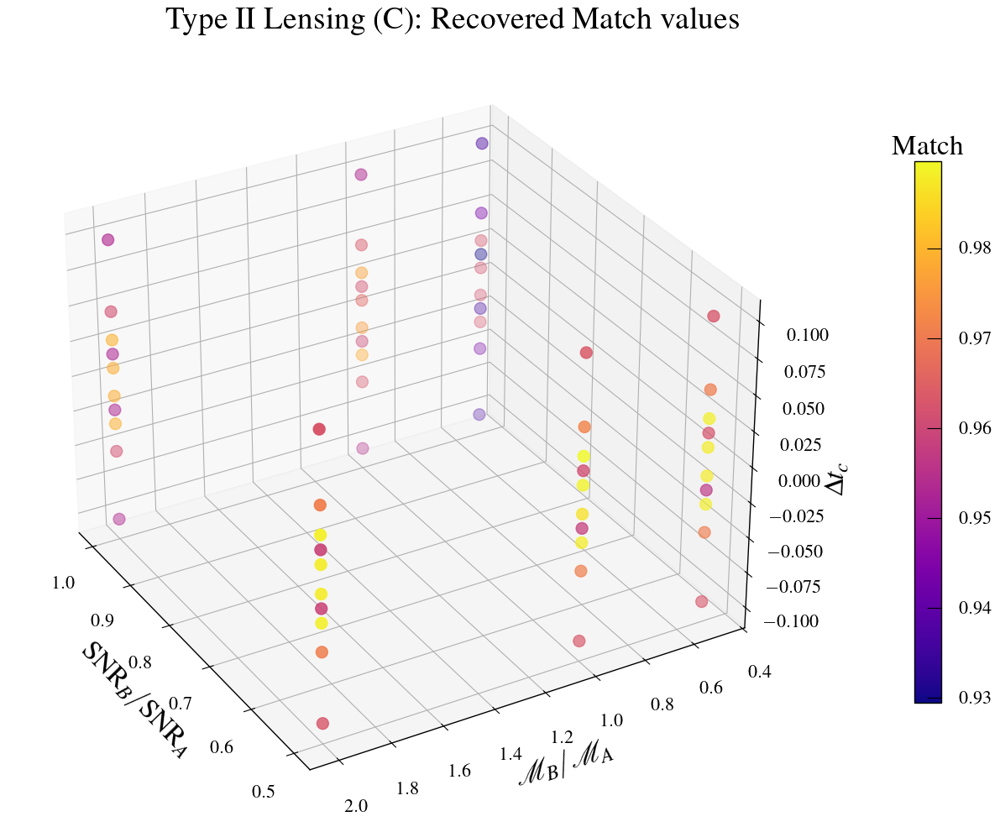

In [ ]:
fig, axes = plt.subplots(1, 1, figsize=(16, 10), subplot_kw={'projection': '3d'})

scatter = axes.scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=match_ml2c, edgecolor=None, cmap='plasma', s=100)
axes.set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes.set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes.set_zlabel('$\Delta t_c$')
axes.ticklabel_format(useOffset=False, style='plain')
axes.azim = 150

clb = fig.colorbar(scatter, ax=axes, shrink=0.7, pad=0.1)
clb.ax.set_title('Match')

plt.suptitle('Type II Lensing (C): Recovered Match values')
plt.tight_layout()
plt.savefig('../../output/pe_population_3G/match/SL2C_MATCH(3D).png')
plt.show()

### Chirp Mass $\mathcal{M}$ Bias

In [20]:
bias_mchirp_a_ml2c = np.abs(mchirp_ml2c-mchirp_a)/mchirp_a*100
bias_mchirp_b_ml2c = np.abs(mchirp_ml2c-mchirp_b)/mchirp_b*100

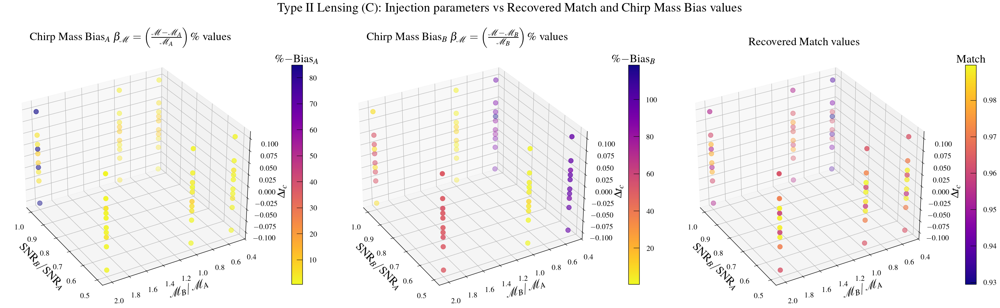

In [ ]:
fig, axes = plt.subplots(1, 3, figsize=(30, 10), subplot_kw={'projection': '3d'})

scatter1 = axes[0].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=bias_mchirp_a_ml2c, edgecolor=None, cmap='plasma_r', s=100)
clb1 = fig.colorbar(scatter1, ax=axes[0], shrink=0.7, pad=0.1)
clb1.ax.set_title('$\\%-$Bias$_A$')
clb1.ax.ticklabel_format(useOffset=False, style='plain')

axes[0].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[0].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[0].set_zlabel('$\Delta t_c$')
axes[0].set_title('Chirp Mass Bias$_A$ $\\beta_{\\mathcal{M}}=\\left(\\frac{\\mathcal{M}-\\mathcal{M}_A}{\\mathcal{M}_A}\\right)\\%$ values', loc='center')
axes[0].ticklabel_format(useOffset=False, style='plain')
axes[0].azim = 150

scatter2 = axes[1].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=bias_mchirp_b_ml2c, edgecolor=None, cmap='plasma_r', s=100)
clb2 = fig.colorbar(scatter2, ax=axes[1], shrink=0.7, pad=0.1)
clb2.ax.set_title('$\\%-$Bias$_B$')
clb2.ax.ticklabel_format(useOffset=False, style='plain')

axes[1].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[1].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[1].set_zlabel('$\Delta t_c$')
axes[1].set_title('Chirp Mass Bias$_B$ $\\beta_{\\mathcal{M}}=\\left(\\frac{\\mathcal{M}-\\mathcal{M}_B}{\\mathcal{M}_B}\\right)\\%$ values', loc='center')
axes[1].ticklabel_format(useOffset=False, style='plain')
axes[1].azim = 150

scatter3 = axes[2].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=match_ml2c, edgecolor=None, cmap='plasma', s=100)
clb3 = fig.colorbar(scatter3, ax=axes[2], shrink=0.7, pad=0.1)
clb3.ax.set_title('Match')
clb3.ax.ticklabel_format(useOffset=False, style='plain')

axes[2].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[2].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[2].set_zlabel('$\Delta t_c$')
axes[2].set_title('Recovered Match values', loc='center')
axes[2].ticklabel_format(useOffset=False, style='plain')
axes[2].azim = 150

fig.suptitle('Type II Lensing (C): Injection parameters vs Recovered Match and Chirp Mass Bias values')
plt.tight_layout()
plt.savefig('../../output/pe_population_3G/match/SL2C_BIAS_MCHIRP(3D).png')
plt.show()

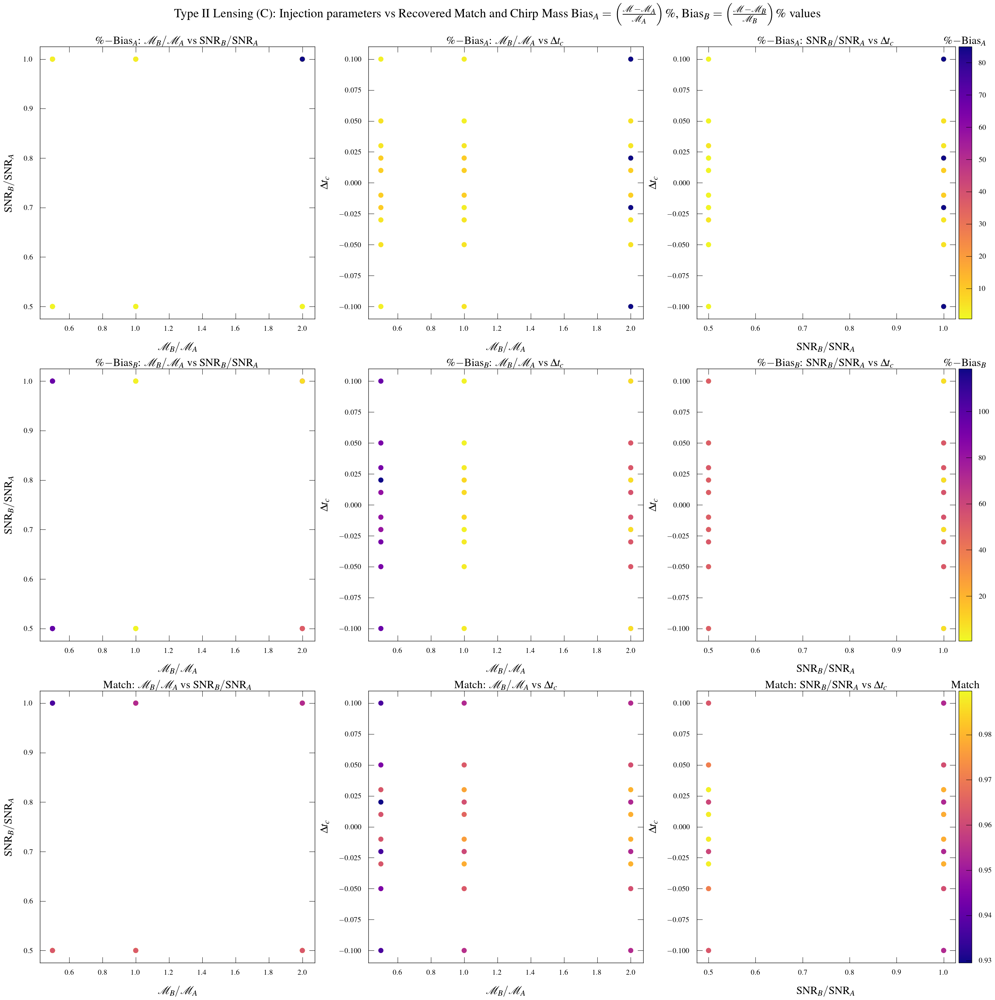

In [ ]:
fig, axes = plt.subplots(3, 3, figsize=(30, 30))

scatter11 = axes[0,0].scatter(mchirp_b/mchirp_a, snr_b/snr_a, c=bias_mchirp_a_ml2c, cmap='plasma_r',s=100)
axes[0,0].set_xlabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[0,0].set_ylabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[0,0].set_title('$\\%-$Bias$_A$: $\mathcal{M}_B/\mathcal{M}_A$ vs $\mathrm{SNR}_B/\mathrm{SNR}_A$')

scatter12 = axes[1,0].scatter(mchirp_b/mchirp_a, snr_b/snr_a, c=bias_mchirp_b_ml2c, cmap='plasma_r', s=100)
axes[1,0].set_xlabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[1,0].set_ylabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[1,0].set_title('$\\%-$Bias$_B$: $\mathcal{M}_B/\mathcal{M}_A$ vs $\mathrm{SNR}_B/\mathrm{SNR}_A$')

scatter13 = axes[2,0].scatter(mchirp_b/mchirp_a, snr_b/snr_a, c=match_ml2c, cmap='plasma', s=100)
axes[2,0].set_xlabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[2,0].set_ylabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[2,0].set_title('Match: $\mathcal{M}_B/\mathcal{M}_A$ vs $\mathrm{SNR}_B/\mathrm{SNR}_A$')

scatter21 = axes[0,1].scatter(mchirp_b/mchirp_a, delta_tc, c=bias_mchirp_a_ml2c, cmap='plasma_r', s=100)
axes[0,1].set_xlabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[0,1].set_ylabel('$\Delta t_c$')
axes[0,1].set_title('$\\%-$Bias$_A$: $\mathcal{M}_B/\mathcal{M}_A$ vs $\Delta t_c$')

scatter22 = axes[1,1].scatter(mchirp_b/mchirp_a, delta_tc, c=bias_mchirp_b_ml2c, cmap='plasma_r', s=100)
axes[1,1].set_xlabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[1,1].set_ylabel('$\Delta t_c$')
axes[1,1].set_title('$\\%-$Bias$_B$: $\mathcal{M}_B/\mathcal{M}_A$ vs $\Delta t_c$')

scatter32 = axes[2,1].scatter(mchirp_b/mchirp_a, delta_tc, c=match_ml2c, cmap='plasma', s=100)
axes[2,1].set_xlabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[2,1].set_ylabel('$\Delta t_c$')
axes[2,1].set_title('Match: $\mathcal{M}_B/\mathcal{M}_A$ vs $\Delta t_c$')

scatter31 = axes[0,2].scatter(snr_b/snr_a, delta_tc, c=bias_mchirp_a_ml2c, cmap='plasma_r', s=100)
divider = make_axes_locatable(axes[0, 2])
cax = divider.append_axes("right", size="5%", pad=0.1)
clb1 = plt.colorbar(scatter31, cax=cax)
clb1.ax.set_title('$\\%-$Bias$_A$')
clb1.ax.ticklabel_format(useOffset=False, style='plain')

axes[0,2].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[0,2].set_ylabel('$\Delta t_c$')
axes[0,2].set_title('$\\%-$Bias$_A$: $\mathrm{SNR}_B/\mathrm{SNR}_A$ vs $\Delta t_c$')

scatter32 = axes[1,2].scatter(snr_b/snr_a, delta_tc, c=bias_mchirp_b_ml2c, cmap='plasma_r', s=100)
divider = make_axes_locatable(axes[1, 2])
cax = divider.append_axes("right", size="5%", pad=0.1)
clb2 = plt.colorbar(scatter32, cax=cax)
clb2.ax.set_title('$\\%-$Bias$_B$')
clb2.ax.ticklabel_format(useOffset=False, style='plain')

axes[1,2].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[1,2].set_ylabel('$\Delta t_c$')
axes[1,2].set_title('$\\%-$Bias$_B$: $\mathrm{SNR}_B/\mathrm{SNR}_A$ vs $\Delta t_c$')

scatter33 = axes[2,2].scatter(snr_b/snr_a, delta_tc, c=match_ml2c, cmap='plasma', s=100)
divider = make_axes_locatable(axes[2, 2])
cax = divider.append_axes("right", size="5%", pad=0.1)
clb3 = plt.colorbar(scatter33, cax=cax)
clb3.ax.set_title('Match')
clb3.ax.ticklabel_format(useOffset=False, style='plain')

axes[2,2].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[2,2].set_ylabel('$\Delta t_c$')
axes[2,2].set_title('Match: $\mathrm{SNR}_B/\mathrm{SNR}_A$ vs $\Delta t_c$')

fig.suptitle('Type II Lensing (C): Injection parameters vs Recovered Match and Chirp Mass Bias$_A$ $=\\left(\\frac{\\mathcal{M}-\\mathcal{M}_A}{\\mathcal{M}_A}\\right)\\%$, Bias$_B$ $=\\left(\\frac{\\mathcal{M}-\\mathcal{M}_B}{\\mathcal{M}_B}\\right)\\%$ values', y=1)
plt.tight_layout()
plt.savefig('../../output/pe_population_3G/match/SL2C_BIAS_MCHIRP(2D).png')
plt.show()

### Lensing Parameters: $n_j$

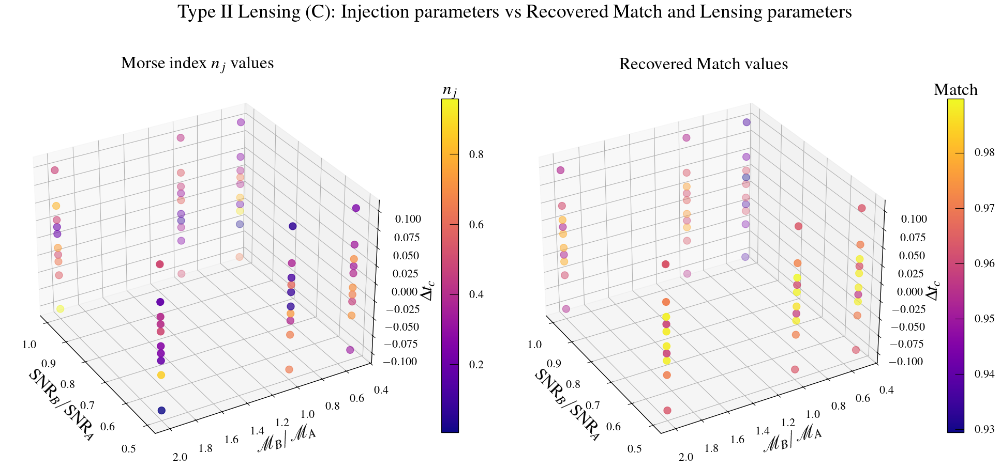

In [ ]:
fig, axes = plt.subplots(1, 2, figsize=(20, 10), subplot_kw={'projection': '3d'})

scatter1 = axes[0].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=n_ml2c, edgecolor=None, cmap='plasma', s=100)
clb1 = fig.colorbar(scatter1, ax=axes[0], shrink=0.7, pad=0.1)
clb1.ax.set_title('$n_j$')

axes[0].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[0].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[0].set_zlabel('$\Delta t_c$')
axes[0].set_title('Morse index $n_j$ values', loc='center')
axes[0].ticklabel_format(useOffset=False, style='plain')
axes[0].azim = 150

scatter3 = axes[1].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=match_ml2c, edgecolor=None, cmap='plasma', s=100)
clb3 = fig.colorbar(scatter3, ax=axes[1], shrink=0.7, pad=0.1)
clb3.ax.set_title('Match')

axes[1].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[1].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[1].set_zlabel('$\Delta t_c$')
axes[1].set_title('Recovered Match values', loc='center')
axes[1].ticklabel_format(useOffset=False, style='plain')
axes[1].azim = 150

fig.suptitle('Type II Lensing (C): Injection parameters vs Recovered Match and Lensing parameters')
plt.tight_layout()
plt.savefig('../../output/pe_population_3G/match/SL2C_PARAMS(3D).png')
plt.show()

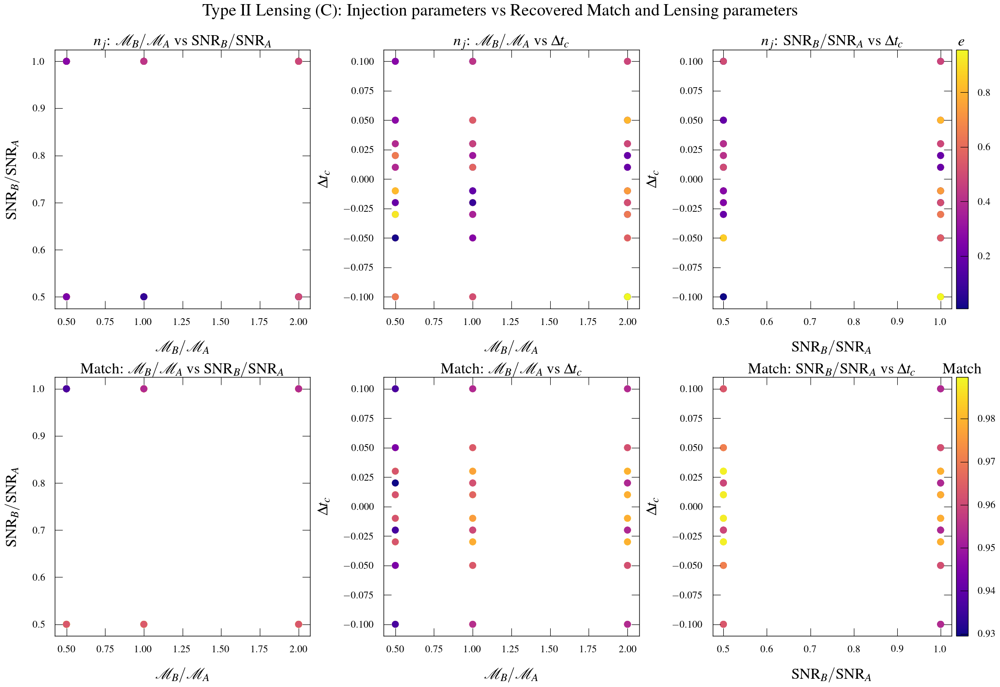

In [ ]:
fig, axes = plt.subplots(2, 3, figsize=(22, 15))

scatter11 = axes[0,0].scatter(mchirp_b/mchirp_a, snr_b/snr_a, c=n_ml2c, cmap='plasma',s=100)
axes[0,0].set_xlabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[0,0].set_ylabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[0,0].set_title('$n_j$: $\mathcal{M}_B/\mathcal{M}_A$ vs $\mathrm{SNR}_B/\mathrm{SNR}_A$')

scatter13 = axes[1,0].scatter(mchirp_b/mchirp_a, snr_b/snr_a, c=match_ml2c, cmap='plasma', s=100)
axes[1,0].set_xlabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[1,0].set_ylabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[1,0].set_title('Match: $\mathcal{M}_B/\mathcal{M}_A$ vs $\mathrm{SNR}_B/\mathrm{SNR}_A$')

scatter21 = axes[0,1].scatter(mchirp_b/mchirp_a, delta_tc, c=n_ml2c, cmap='plasma', s=100)
axes[0,1].set_xlabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[0,1].set_ylabel('$\Delta t_c$')
axes[0,1].set_title('$n_j$: $\mathcal{M}_B/\mathcal{M}_A$ vs $\Delta t_c$')

scatter32 = axes[1,1].scatter(mchirp_b/mchirp_a, delta_tc, c=match_ml2c, cmap='plasma', s=100)
axes[1,1].set_xlabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[1,1].set_ylabel('$\Delta t_c$')
axes[1,1].set_title('Match: $\mathcal{M}_B/\mathcal{M}_A$ vs $\Delta t_c$')

scatter31 = axes[0,2].scatter(snr_b/snr_a, delta_tc, c=n_ml2c, cmap='plasma', s=100)
divider = make_axes_locatable(axes[0, 2])
cax = divider.append_axes("right", size="5%", pad=0.1)
clb1 = plt.colorbar(scatter31, cax=cax)
clb1.ax.set_title('$e$')
axes[0,2].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[0,2].set_ylabel('$\Delta t_c$')
axes[0,2].set_title('$n_j$: $\mathrm{SNR}_B/\mathrm{SNR}_A$ vs $\Delta t_c$')

scatter33 = axes[1,2].scatter(snr_b/snr_a, delta_tc, c=match_ml2c, cmap='plasma', s=100)
divider = make_axes_locatable(axes[1, 2])
cax = divider.append_axes("right", size="5%", pad=0.1)
clb3 = plt.colorbar(scatter33, cax=cax)
clb3.ax.set_title('Match')
axes[1,2].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[1,2].set_ylabel('$\Delta t_c$')
axes[1,2].set_title('Match: $\mathrm{SNR}_B/\mathrm{SNR}_A$ vs $\Delta t_c$')

fig.suptitle('Type II Lensing (C): Injection parameters vs Recovered Match and Lensing parameters', y=1)
plt.tight_layout()
plt.savefig('../../output/pe_population_3G/match/SL2C_PARAMS(2D).png')
plt.show()

## Eccentric Recovery

In [ ]:
match_ecc, mchirp_ecc, eta_ecc, e_ecc = np.zeros(len(combinations)), np.zeros(len(combinations)), np.zeros(len(combinations)), np.zeros(len(combinations))
for i in range(len(combinations)):
    try:
        data_H1 = np.load('../../output/pe_population_3G/FF/FF_ECC_3D_H1_{}_{}_{}.npy'.format(combinations[i][0], combinations[i][1], combinations[i][2]), allow_pickle=True)
        match_ecc_H1, mchirp_ecc_H1, eta_ecc_H1, e_ecc_H1 = data_H1[0], data_H1[1], data_H1[2], data_H1[3]
        data_L1 = np.load('../../output/pe_population_3G/FF/FF_ECC_3D_L1_{}_{}_{}.npy'.format(combinations[i][0], combinations[i][1], combinations[i][2]), allow_pickle=True)
        match_ecc_L1, mchirp_ecc_L1, eta_ecc_L1, e_ecc_L1 = data_L1[0], data_L1[1], data_L1[2], data_L1[3]
        data_V1 = np.load('../../output/pe_population_3G/FF/FF_ECC_3D_V1_{}_{}_{}.npy'.format(combinations[i][0], combinations[i][1], combinations[i][2]), allow_pickle=True)
        match_ecc_V1, mchirp_ecc_V1, eta_ecc_V1, e_ecc_V1 = data_V1[0], data_V1[1], data_V1[2], data_V1[3]

        match_ecc[i] = np.sqrt(np.mean([match_ecc_H1**2, match_ecc_L1**2, match_ecc_V1**2]))
        if match_ecc_H1 > match_ecc_L1 and match_ecc_H1 > match_ecc_V1:
            mchirp_ecc[i], eta_ecc[i], e_ecc[i] = mchirp_ecc_H1, eta_ecc_H1, e_ecc_H1
        elif match_ecc_L1 > match_ecc_H1 and match_ecc_L1 > match_ecc_V1:
            mchirp_ecc[i], eta_ecc[i], e_ecc[i] = mchirp_ecc_L1, eta_ecc_L1, e_ecc_L1
        else:
            mchirp_ecc[i], eta_ecc[i], e_ecc[i] = mchirp_ecc_V1, eta_ecc_V1, e_ecc_V1
    except:
        data = np.load('../../output/pe_population_3G/FF/FF_ECC_3D_H1_{}_{}_{}.npy'.format(combinations[i][0], combinations[i][1], combinations[i][2]), allow_pickle=True)
        match_ecc[i], mchirp_ecc[i], eta_ecc[i], e_ecc[i] = data[0], data[1], data[2], data[3]

In [ ]:
match_ecc_0, mchirp_ecc_0, eta_ecc_0 = np.zeros(len(combinations)), np.zeros(len(combinations)), np.zeros(len(combinations))
for i in range(len(combinations)):
    try:
        data_H1 = np.load('../../output/pe_population_3G/FF/FF_ECC_0_2D_H1_{}_{}_{}.npy'.format(combinations[i][0], combinations[i][1], combinations[i][2]), allow_pickle=True)
        match_ecc_0_H1, mchirp_ecc_0_H1, eta_ecc_0_H1 = data_H1[0], data_H1[1], data_H1[2]
        data_L1 = np.load('../../output/pe_population_3G/FF/FF_ECC_0_2D_L1_{}_{}_{}.npy'.format(combinations[i][0], combinations[i][1], combinations[i][2]), allow_pickle=True)
        match_ecc_0_L1, mchirp_ecc_0_L1, eta_ecc_0_L1 = data_L1[0], data_L1[1], data_L1[2]
        data_V1 = np.load('../../output/pe_population_3G/FF/FF_ECC_0_2D_V1_{}_{}_{}.npy'.format(combinations[i][0], combinations[i][1], combinations[i][2]), allow_pickle=True)
        match_ecc_0_V1, mchirp_ecc_0_V1, eta_ecc_0_V1 = data_V1[0], data_V1[1], data_V1[2]

        match_ecc_0[i] = np.sqrt(np.mean([match_ecc_0_H1**2, match_ecc_0_L1**2, match_ecc_0_V1**2]))
        if match_ecc_0_H1 > match_ecc_0_L1 and match_ecc_0_H1 > match_ecc_0_V1:
            mchirp_ecc_0[i], eta_ecc_0[i] = mchirp_ecc_0_H1, eta_ecc_0_H1
        elif match_ecc_0_L1 > match_ecc_0_H1 and match_ecc_0_L1 > match_ecc_0_V1:
            mchirp_ecc_0[i], eta_ecc_0[i] = mchirp_ecc_0_L1, eta_ecc_0_L1
        else:
            mchirp_ecc_0[i], eta_ecc_0[i] = mchirp_ecc_0_V1, eta_ecc_0_V1
    except:
        data = np.load('../../output/pe_population_3G/FF/FF_ECC_0_2D_H1_{}_{}_{}.npy'.format(combinations[i][0], combinations[i][1], combinations[i][2]), allow_pickle=True)
        match_ecc_0[i], mchirp_ecc_0[i], eta_ecc_0[i] = data[0], data[1], data[2]

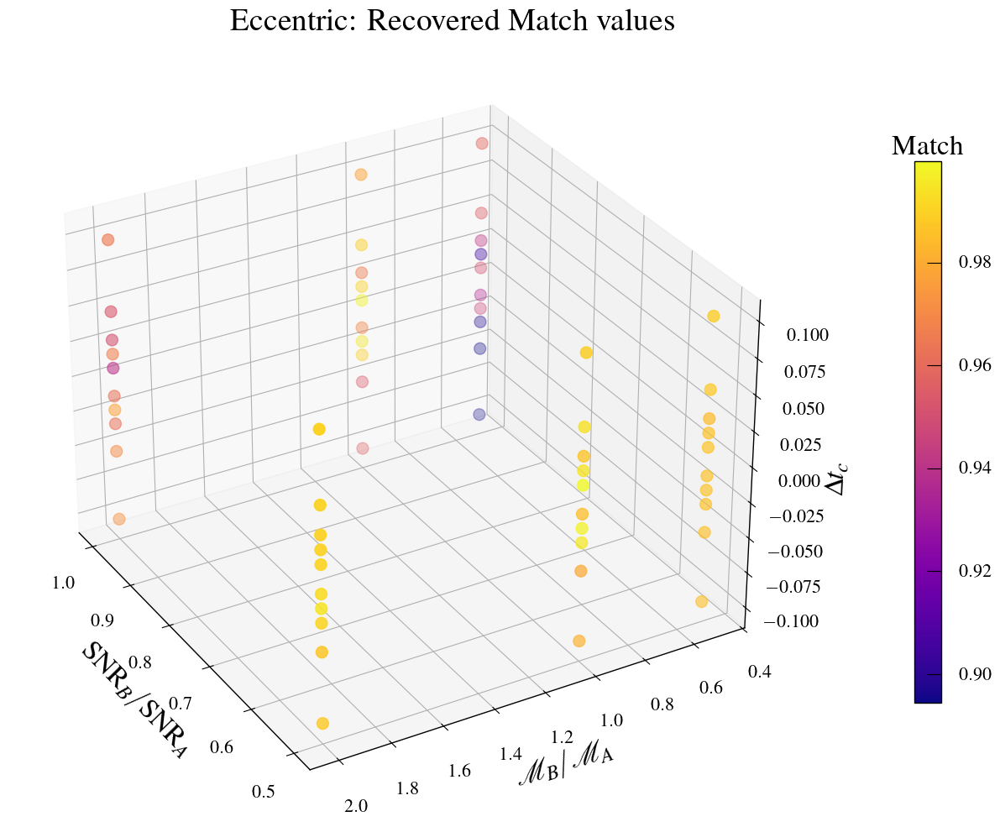

In [ ]:
fig, axes = plt.subplots(1, 1, figsize=(16, 10), subplot_kw={'projection': '3d'})

scatter = axes.scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=match_ecc, edgecolor=None, cmap='plasma', s=100)
axes.set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes.set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes.set_zlabel('$\Delta t_c$')
axes.ticklabel_format(useOffset=False, style='plain')
axes.azim = 150

clb = fig.colorbar(scatter, ax=axes, shrink=0.7, pad=0.1)
clb.ax.set_title('Match')

plt.suptitle('Eccentric: Recovered Match values')
plt.tight_layout()
plt.savefig('../../output/pe_population_3G/match/ECC_MATCH(3D).png')
plt.show()

### Chirp Mass $\mathcal{M}$ Bias

In [28]:
bias_mchirp_a_ecc = np.abs(mchirp_ecc-mchirp_a)/mchirp_a*100
bias_mchirp_b_ecc = np.abs(mchirp_ecc-mchirp_b)/mchirp_b*100

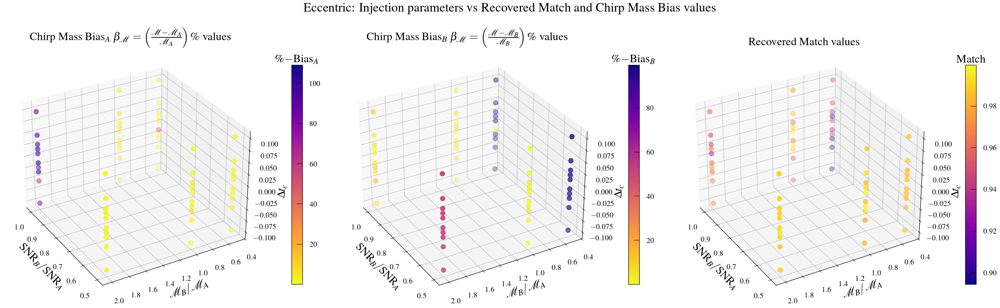

In [ ]:
fig, axes = plt.subplots(1, 3, figsize=(30, 10), subplot_kw={'projection': '3d'})

scatter1 = axes[0].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=bias_mchirp_a_ecc, edgecolor=None, cmap='plasma_r', s=100)
clb1 = fig.colorbar(scatter1, ax=axes[0], shrink=0.7, pad=0.1)
clb1.ax.set_title('$\\%-$Bias$_A$')
clb1.ax.ticklabel_format(useOffset=False, style='plain')

axes[0].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[0].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[0].set_zlabel('$\Delta t_c$')
axes[0].set_title('Chirp Mass Bias$_A$ $\\beta_{\\mathcal{M}}=\\left(\\frac{\\mathcal{M}-\\mathcal{M}_A}{\\mathcal{M}_A}\\right)\\%$ values', loc='center')
axes[0].ticklabel_format(useOffset=False, style='plain')
axes[0].azim = 150

scatter2 = axes[1].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=bias_mchirp_b_ecc, edgecolor=None, cmap='plasma_r', s=100)
clb2 = fig.colorbar(scatter2, ax=axes[1], shrink=0.7, pad=0.1)
clb2.ax.set_title('$\\%-$Bias$_B$')
clb2.ax.ticklabel_format(useOffset=False, style='plain')

axes[1].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[1].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[1].set_zlabel('$\Delta t_c$')
axes[1].set_title('Chirp Mass Bias$_B$ $\\beta_{\\mathcal{M}}=\\left(\\frac{\\mathcal{M}-\\mathcal{M}_B}{\\mathcal{M}_B}\\right)\\%$ values', loc='center')
axes[1].ticklabel_format(useOffset=False, style='plain')
axes[1].azim = 150

scatter3 = axes[2].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=match_ecc, edgecolor=None, cmap='plasma', s=100)
clb3 = fig.colorbar(scatter3, ax=axes[2], shrink=0.7, pad=0.1)
clb3.ax.set_title('Match')
clb3.ax.ticklabel_format(useOffset=False, style='plain')

axes[2].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[2].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[2].set_zlabel('$\Delta t_c$')
axes[2].set_title('Recovered Match values', loc='center')
axes[2].ticklabel_format(useOffset=False, style='plain')
axes[2].azim = 150

fig.suptitle('Eccentric: Injection parameters vs Recovered Match and Chirp Mass Bias values')
plt.tight_layout()
plt.savefig('../../output/pe_population_3G/match/ECC_BIAS_MCHIRP(3D).png')
plt.show()

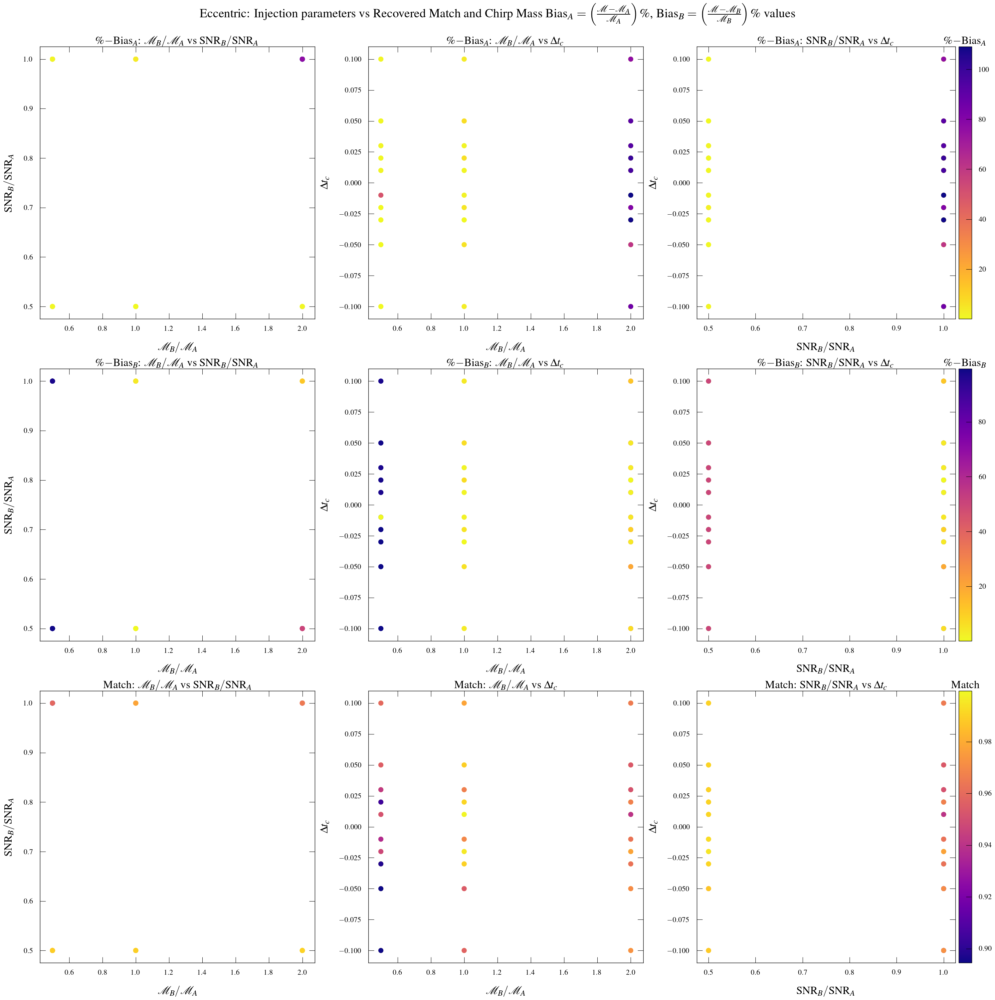

In [ ]:
fig, axes = plt.subplots(3, 3, figsize=(30, 30))

scatter11 = axes[0,0].scatter(mchirp_b/mchirp_a, snr_b/snr_a, c=bias_mchirp_a_ecc, cmap='plasma_r',s=100)
axes[0,0].set_xlabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[0,0].set_ylabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[0,0].set_title('$\\%-$Bias$_A$: $\mathcal{M}_B/\mathcal{M}_A$ vs $\mathrm{SNR}_B/\mathrm{SNR}_A$')

scatter12 = axes[1,0].scatter(mchirp_b/mchirp_a, snr_b/snr_a, c=bias_mchirp_b_ecc, cmap='plasma_r', s=100)
axes[1,0].set_xlabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[1,0].set_ylabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[1,0].set_title('$\\%-$Bias$_B$: $\mathcal{M}_B/\mathcal{M}_A$ vs $\mathrm{SNR}_B/\mathrm{SNR}_A$')

scatter13 = axes[2,0].scatter(mchirp_b/mchirp_a, snr_b/snr_a, c=match_ecc, cmap='plasma', s=100)
axes[2,0].set_xlabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[2,0].set_ylabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[2,0].set_title('Match: $\mathcal{M}_B/\mathcal{M}_A$ vs $\mathrm{SNR}_B/\mathrm{SNR}_A$')

scatter21 = axes[0,1].scatter(mchirp_b/mchirp_a, delta_tc, c=bias_mchirp_a_ecc, cmap='plasma_r', s=100)
axes[0,1].set_xlabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[0,1].set_ylabel('$\Delta t_c$')
axes[0,1].set_title('$\\%-$Bias$_A$: $\mathcal{M}_B/\mathcal{M}_A$ vs $\Delta t_c$')

scatter22 = axes[1,1].scatter(mchirp_b/mchirp_a, delta_tc, c=bias_mchirp_b_ecc, cmap='plasma_r', s=100)
axes[1,1].set_xlabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[1,1].set_ylabel('$\Delta t_c$')
axes[1,1].set_title('$\\%-$Bias$_B$: $\mathcal{M}_B/\mathcal{M}_A$ vs $\Delta t_c$')

scatter32 = axes[2,1].scatter(mchirp_b/mchirp_a, delta_tc, c=match_ecc, cmap='plasma', s=100)
axes[2,1].set_xlabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[2,1].set_ylabel('$\Delta t_c$')
axes[2,1].set_title('Match: $\mathcal{M}_B/\mathcal{M}_A$ vs $\Delta t_c$')

scatter31 = axes[0,2].scatter(snr_b/snr_a, delta_tc, c=bias_mchirp_a_ecc, cmap='plasma_r', s=100)
divider = make_axes_locatable(axes[0, 2])
cax = divider.append_axes("right", size="5%", pad=0.1)
clb1 = plt.colorbar(scatter31, cax=cax)
clb1.ax.set_title('$\\%-$Bias$_A$')
clb1.ax.ticklabel_format(useOffset=False, style='plain')

axes[0,2].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[0,2].set_ylabel('$\Delta t_c$')
axes[0,2].set_title('$\\%-$Bias$_A$: $\mathrm{SNR}_B/\mathrm{SNR}_A$ vs $\Delta t_c$')

scatter32 = axes[1,2].scatter(snr_b/snr_a, delta_tc, c=bias_mchirp_b_ecc, cmap='plasma_r', s=100)
divider = make_axes_locatable(axes[1, 2])
cax = divider.append_axes("right", size="5%", pad=0.1)
clb2 = plt.colorbar(scatter32, cax=cax)
clb2.ax.set_title('$\\%-$Bias$_B$')
clb2.ax.ticklabel_format(useOffset=False, style='plain')

axes[1,2].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[1,2].set_ylabel('$\Delta t_c$')
axes[1,2].set_title('$\\%-$Bias$_B$: $\mathrm{SNR}_B/\mathrm{SNR}_A$ vs $\Delta t_c$')

scatter33 = axes[2,2].scatter(snr_b/snr_a, delta_tc, c=match_ecc, cmap='plasma', s=100)
divider = make_axes_locatable(axes[2, 2])
cax = divider.append_axes("right", size="5%", pad=0.1)
clb3 = plt.colorbar(scatter33, cax=cax)
clb3.ax.set_title('Match')
clb3.ax.ticklabel_format(useOffset=False, style='plain')

axes[2,2].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[2,2].set_ylabel('$\Delta t_c$')
axes[2,2].set_title('Match: $\mathrm{SNR}_B/\mathrm{SNR}_A$ vs $\Delta t_c$')

fig.suptitle('Eccentric: Injection parameters vs Recovered Match and Chirp Mass Bias$_A$ $=\\left(\\frac{\\mathcal{M}-\\mathcal{M}_A}{\\mathcal{M}_A}\\right)\\%$, Bias$_B$ $=\\left(\\frac{\\mathcal{M}-\\mathcal{M}_B}{\\mathcal{M}_B}\\right)\\%$ values', y=1)
plt.tight_layout()
plt.savefig('../../output/pe_population_3G/match/ECC_BIAS_MCHIRP(2D).png')
plt.show()

### Eccentric Parameters: $e$

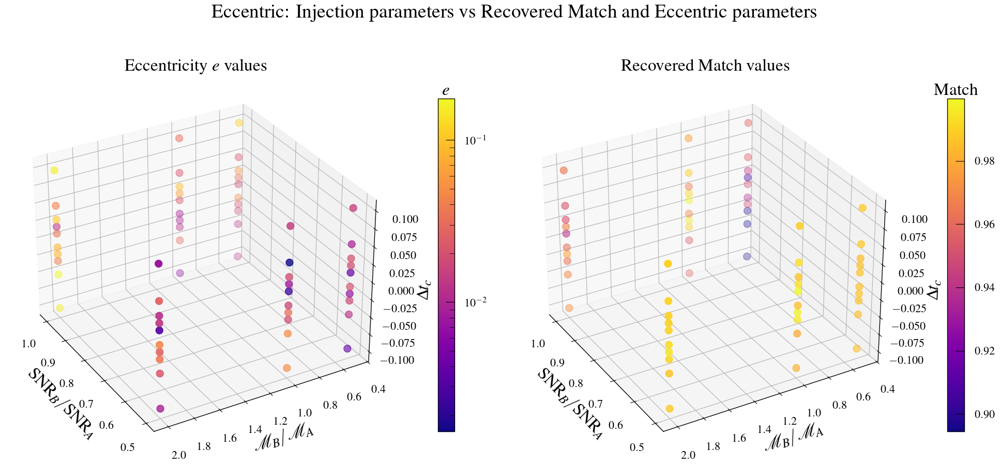

In [ ]:
fig, axes = plt.subplots(1, 2, figsize=(20, 10), subplot_kw={'projection': '3d'})

scatter1 = axes[0].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=e_ecc, edgecolor=None, cmap='plasma', s=100, norm=matplotlib.colors.LogNorm())
clb1 = fig.colorbar(scatter1, ax=axes[0], shrink=0.7, pad=0.1)
clb1.ax.set_title('$e$')

axes[0].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[0].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[0].set_zlabel('$\Delta t_c$')
axes[0].set_title('Eccentricity $e$ values', loc='center')
axes[0].ticklabel_format(useOffset=False, style='plain')
axes[0].azim = 150

scatter3 = axes[1].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=match_ecc, edgecolor=None, cmap='plasma', s=100)
clb3 = fig.colorbar(scatter3, ax=axes[1], shrink=0.7, pad=0.1)
clb3.ax.set_title('Match')

axes[1].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[1].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[1].set_zlabel('$\Delta t_c$')
axes[1].set_title('Recovered Match values', loc='center')
axes[1].ticklabel_format(useOffset=False, style='plain')
axes[1].azim = 150

fig.suptitle('Eccentric: Injection parameters vs Recovered Match and Eccentric parameters')
plt.tight_layout()
plt.savefig('../../output/pe_population_3G/match/ECC_PARAMS(3D).png')
plt.show()

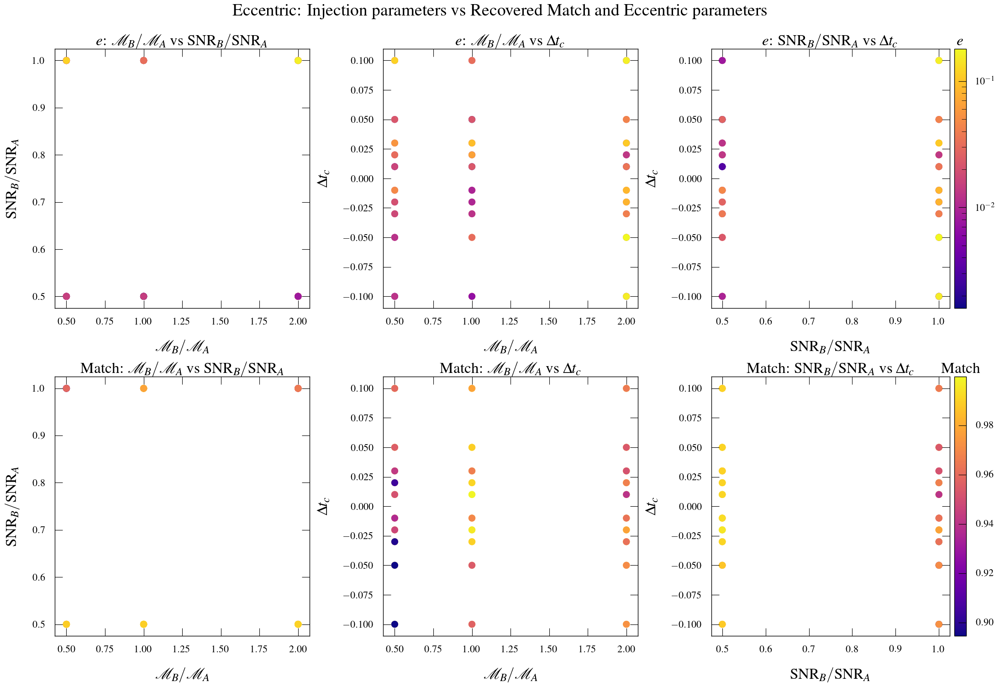

In [ ]:
fig, axes = plt.subplots(2, 3, figsize=(22, 15))

scatter11 = axes[0,0].scatter(mchirp_b/mchirp_a, snr_b/snr_a, c=e_ecc, cmap='plasma',s=100, norm=matplotlib.colors.LogNorm())
axes[0,0].set_xlabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[0,0].set_ylabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[0,0].set_title('$e$: $\mathcal{M}_B/\mathcal{M}_A$ vs $\mathrm{SNR}_B/\mathrm{SNR}_A$')

scatter13 = axes[1,0].scatter(mchirp_b/mchirp_a, snr_b/snr_a, c=match_ecc, cmap='plasma', s=100)
axes[1,0].set_xlabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[1,0].set_ylabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[1,0].set_title('Match: $\mathcal{M}_B/\mathcal{M}_A$ vs $\mathrm{SNR}_B/\mathrm{SNR}_A$')

scatter21 = axes[0,1].scatter(mchirp_b/mchirp_a, delta_tc, c=e_ecc, cmap='plasma', s=100, norm=matplotlib.colors.LogNorm())
axes[0,1].set_xlabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[0,1].set_ylabel('$\Delta t_c$')
axes[0,1].set_title('$e$: $\mathcal{M}_B/\mathcal{M}_A$ vs $\Delta t_c$')

scatter32 = axes[1,1].scatter(mchirp_b/mchirp_a, delta_tc, c=match_ecc, cmap='plasma', s=100)
axes[1,1].set_xlabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[1,1].set_ylabel('$\Delta t_c$')
axes[1,1].set_title('Match: $\mathcal{M}_B/\mathcal{M}_A$ vs $\Delta t_c$')

scatter31 = axes[0,2].scatter(snr_b/snr_a, delta_tc, c=e_ecc, cmap='plasma', s=100, norm=matplotlib.colors.LogNorm())
divider = make_axes_locatable(axes[0, 2])
cax = divider.append_axes("right", size="5%", pad=0.1)
clb1 = plt.colorbar(scatter31, cax=cax)
clb1.ax.set_title('$e$')
axes[0,2].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[0,2].set_ylabel('$\Delta t_c$')
axes[0,2].set_title('$e$: $\mathrm{SNR}_B/\mathrm{SNR}_A$ vs $\Delta t_c$')

scatter33 = axes[1,2].scatter(snr_b/snr_a, delta_tc, c=match_ecc, cmap='plasma', s=100)
divider = make_axes_locatable(axes[1, 2])
cax = divider.append_axes("right", size="5%", pad=0.1)
clb3 = plt.colorbar(scatter33, cax=cax)
clb3.ax.set_title('Match')
axes[1,2].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[1,2].set_ylabel('$\Delta t_c$')
axes[1,2].set_title('Match: $\mathrm{SNR}_B/\mathrm{SNR}_A$ vs $\Delta t_c$')

fig.suptitle('Eccentric: Injection parameters vs Recovered Match and Eccentric parameters', y=1)
plt.tight_layout()
plt.savefig('../../output/pe_population_3G/match/ECC_PARAMS(2D).png')
plt.show()

## Singles Recovery

In [ ]:
match, mchirp, eta, = np.zeros(len(combinations)), np.zeros(len(combinations)), np.zeros(len(combinations))
for i in range(len(combinations)):
    try:
        data_H1 = np.load('../../output/pe_population_3G/FF/FF_3D_H1_{}_{}_{}.npy'.format(combinations[i][0], combinations[i][1], combinations[i][2]), allow_pickle=True)
        match_H1, mchirp_H1, eta_H1 = data_H1[0], data_H1[1], data_H1[2]
        data_L1 = np.load('../../output/pe_population_3G/FF/FF_3D_L1_{}_{}_{}.npy'.format(combinations[i][0], combinations[i][1], combinations[i][2]), allow_pickle=True)
        match_L1, mchirp_L1, eta_L1 = data_L1[0], data_L1[1], data_L1[2]
        data_V1 = np.load('../../output/pe_population_3G/FF/FF_3D_V1_{}_{}_{}.npy'.format(combinations[i][0], combinations[i][1], combinations[i][2]), allow_pickle=True)
        match_V1, mchirp_V1, eta_V1 = data_V1[0], data_V1[1], data_V1[2]

        match[i] = np.sqrt(np.mean([match_H1**2, match_L1**2, match_V1**2]))
        if match_H1 > match_L1 and match_H1 > match_V1:
            mchirp[i], eta[i] = mchirp_H1, eta_H1
        elif match_L1 > match_H1 and match_L1 > match_V1:
            mchirp[i], eta[i] = mchirp_L1, eta_L1
        else:
            mchirp[i], eta[i] = mchirp_V1, eta_V1
    except:
        data = np.load('../../output/pe_population_3G/FF/FF_2D_H1_{}_{}_{}.npy'.format(combinations[i][0], combinations[i][1], combinations[i][2]), allow_pickle=True)
        match[i], mchirp[i], eta[i], = data[0], data[1], data[2]

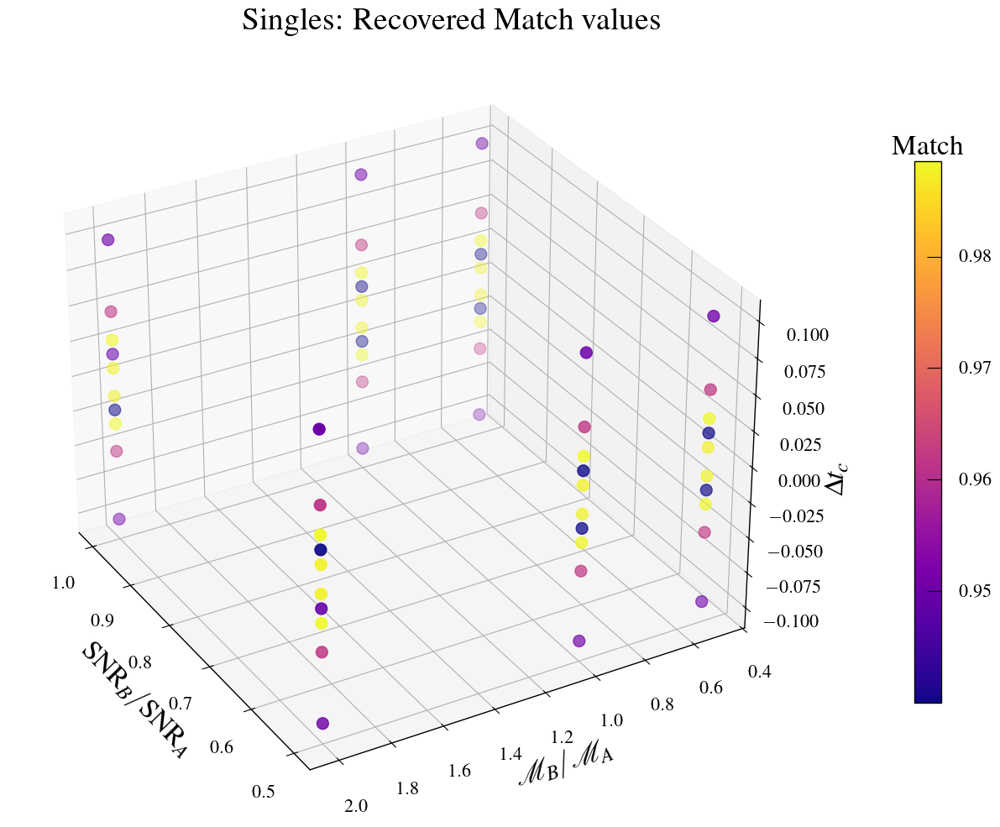

In [ ]:
fig, axes = plt.subplots(1, 1, figsize=(16, 10), subplot_kw={'projection': '3d'})

scatter = axes.scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=match, edgecolor=None, cmap='plasma', s=100)
axes.set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes.set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes.set_zlabel('$\Delta t_c$')
axes.ticklabel_format(useOffset=False, style='plain')
axes.azim = 150

clb = fig.colorbar(scatter, ax=axes, shrink=0.7, pad=0.1)
clb.ax.set_title('Match')

plt.suptitle('Singles: Recovered Match values')
plt.tight_layout()
plt.savefig('../../output/pe_population_3G/match/MATCH(3D).png')
plt.show()

### Comparisions

In [35]:
bias_mchirp_a = np.abs(mchirp-mchirp_a)/mchirp_a*100
bias_mchirp_b = np.abs(mchirp-mchirp_b)/mchirp_b*100

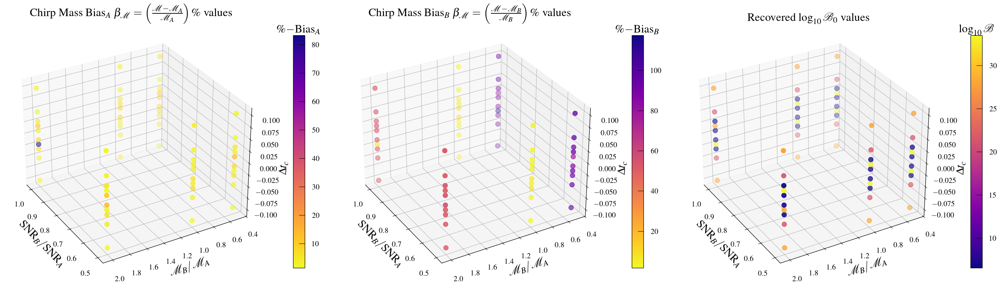

In [ ]:
fig, axes = plt.subplots(1, 3, figsize=(30, 10), subplot_kw={'projection': '3d'})

scatter1 = axes[0].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=bias_mchirp_a_ml, edgecolor=None, cmap='plasma_r', s=100)
clb1 = fig.colorbar(scatter1, ax=axes[0], shrink=0.7, pad=0.1)
clb1.ax.set_title('$\\%-$Bias$_A$')
clb1.ax.ticklabel_format(useOffset=False, style='plain')

axes[0].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[0].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[0].set_zlabel('$\Delta t_c$')
axes[0].set_title('Chirp Mass Bias$_A$ $\\beta_{\\mathcal{M}}=\\left(\\frac{\\mathcal{M}-\\mathcal{M}_A}{\\mathcal{M}_A}\\right)\\%$ values', loc='center')
axes[0].ticklabel_format(useOffset=False, style='plain')
axes[0].azim = 150

scatter2 = axes[1].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=bias_mchirp_b_ml, edgecolor=None, cmap='plasma_r', s=100)
clb2 = fig.colorbar(scatter2, ax=axes[1], shrink=0.7, pad=0.1)
clb2.ax.set_title('$\\%-$Bias$_B$')
clb2.ax.ticklabel_format(useOffset=False, style='plain')

axes[1].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[1].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[1].set_zlabel('$\Delta t_c$')
axes[1].set_title('Chirp Mass Bias$_B$ $\\beta_{\\mathcal{M}}=\\left(\\frac{\\mathcal{M}-\\mathcal{M}_B}{\\mathcal{M}_B}\\right)\\%$ values', loc='center')
axes[1].ticklabel_format(useOffset=False, style='plain')
axes[1].azim = 150

log_bayes_factor_0 = snr_a**2*(1-match**2)/2

scatter3 = axes[2].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=log_bayes_factor_0, edgecolor=None, cmap='plasma', s=100)
clb3 = fig.colorbar(scatter3, ax=axes[2], shrink=0.7, pad=0.1)
clb3.ax.set_title('$\\log_{10}\\mathcal{B}$')
clb3.ax.ticklabel_format(useOffset=False, style='plain')

axes[2].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[2].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[2].set_zlabel('$\Delta t_c$')
axes[2].set_title('Recovered $\log_{10}\mathcal{B}_{0}$ values', loc='center')
axes[2].ticklabel_format(useOffset=False, style='plain')
axes[2].azim = 150

plt.tight_layout()
plt.savefig('../../output/pe_population_3G/match/SinglesFF.pdf', dpi=600, bbox_inches='tight')
plt.show()
plt.close()

### Microlensed

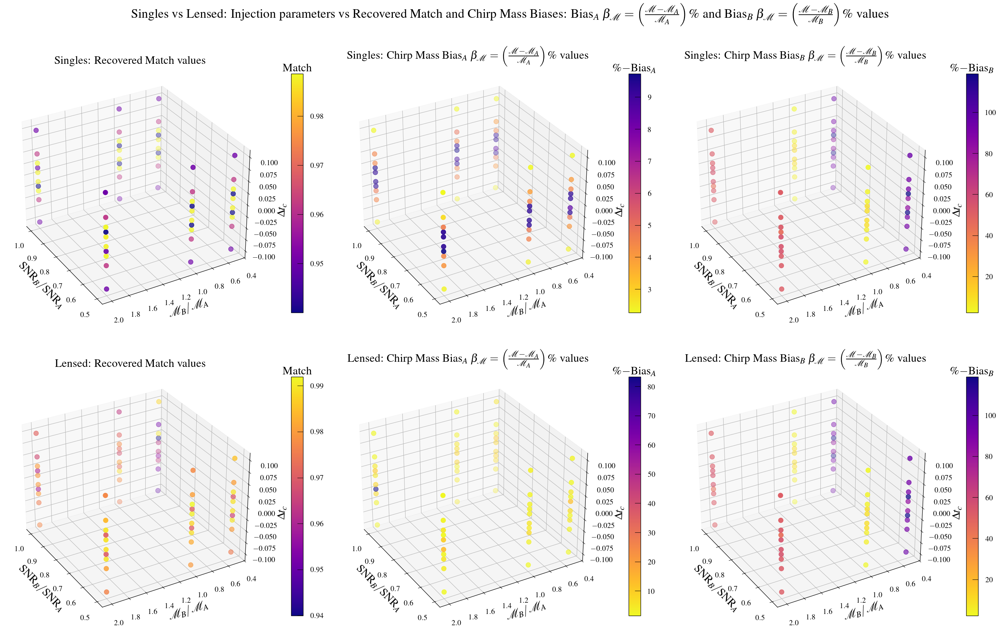

In [ ]:
fig, axes = plt.subplots(2, 3, figsize=(30, 20), subplot_kw={'projection': '3d'})

scatter1 = axes[0,0].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=match, edgecolor=None, cmap='plasma', s=100)
clb0 = fig.colorbar(scatter1, ax=axes[0,0], shrink=0.7, pad=0.1)
clb0.ax.set_title('Match')
clb0.ax.ticklabel_format(useOffset=False, style='plain')

axes[0,0].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[0,0].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[0,0].set_zlabel('$\Delta t_c$')
axes[0,0].ticklabel_format(useOffset=False, style='plain')
axes[0,0].azim = 150

axes[0,0].set_title('Singles: Recovered Match values', loc='center')

ax1 = axes[0,1].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=bias_mchirp_a, cmap='plasma_r', s=100)
clb1 = plt.colorbar(ax1, ax=axes[0,1], shrink=0.7, norm=None, pad=0.1)
clb1.ax.set_title('$\\%-$Bias$_A$')
clb1.ax.ticklabel_format(useOffset=False, style='plain')

axes[0,1].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[0,1].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[0,1].set_zlabel('$\Delta t_c$')
axes[0,1].ticklabel_format(useOffset=False, style='plain')
axes[0,1].azim = 150

axes[0,1].set_title('Singles: Chirp Mass Bias$_A$ $\\beta_{\\mathcal{M}}=\\left(\\frac{\\mathcal{M}-\\mathcal{M}_A}{\\mathcal{M}_A}\\right)\\%$ values', loc='center')

ax2 = axes[0,2].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=bias_mchirp_b, cmap='plasma_r', s=100)
clb2 = plt.colorbar(ax2, ax=axes[0,2], shrink=0.7, norm=None, pad=0.1)
clb2.ax.set_title('$\\%-$Bias$_B$')
clb2.ax.ticklabel_format(useOffset=False, style='plain')

axes[0,2].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[0,2].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[0,2].set_zlabel('$\Delta t_c$')
axes[0,2].ticklabel_format(useOffset=False, style='plain')
axes[0,2].azim = 150

axes[0,2].set_title('Singles: Chirp Mass Bias$_B$ $\\beta_{\\mathcal{M}}=\\left(\\frac{\\mathcal{M}-\\mathcal{M}_B}{\\mathcal{M}_B}\\right)\\%$ values', loc='center')

scatter2 = axes[1,0].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=match_ml, edgecolor=None, cmap='plasma', s=100)
clb2 = fig.colorbar(scatter2, ax=axes[1,0], shrink=0.7, pad=0.1)
clb2.ax.set_title('Match')
clb2.ax.ticklabel_format(useOffset=False, style='plain')

axes[1,0].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[1,0].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[1,0].set_zlabel('$\Delta t_c$')
axes[1,0].ticklabel_format(useOffset=False, style='plain')
axes[1,0].azim = 150

axes[1,0].set_title('Lensed: Recovered Match values', loc='center')

ax3 = axes[1,1].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=bias_mchirp_a_ml, cmap='plasma_r', s=100)
clb3 = plt.colorbar(ax3, ax=axes[1,1], shrink=0.7, norm=None, pad=0.1)
clb3.ax.set_title('$\\%-$Bias$_A$')
clb3.ax.ticklabel_format(useOffset=False, style='plain')

axes[1,1].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[1,1].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[1,1].set_zlabel('$\Delta t_c$')
axes[1,1].ticklabel_format(useOffset=False, style='plain')
axes[1,1].azim = 150

axes[1,1].set_title('Lensed: Chirp Mass Bias$_A$ $\\beta_{\\mathcal{M}}=\\left(\\frac{\\mathcal{M}-\\mathcal{M}_A}{\\mathcal{M}_A}\\right)\\%$ values', loc='center')

ax4 = axes[1,2].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=bias_mchirp_b, cmap='plasma_r', s=100)
clb4 = plt.colorbar(ax4, ax=axes[1,2], shrink=0.7, norm=None, pad=0.1)
clb4.ax.set_title('$\\%-$Bias$_B$')
clb4.ax.ticklabel_format(useOffset=False, style='plain')

axes[1,2].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[1,2].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[1,2].set_zlabel('$\Delta t_c$')
axes[1,2].ticklabel_format(useOffset=False, style='plain')
axes[1,2].azim = 150

axes[1,2].set_title('Lensed: Chirp Mass Bias$_B$ $\\beta_{\\mathcal{M}}=\\left(\\frac{\\mathcal{M}-\\mathcal{M}_B}{\\mathcal{M}_B}\\right)\\%$ values', loc='center')

fig.suptitle('Singles vs Lensed: Injection parameters vs Recovered Match and Chirp Mass Biases: Bias$_A$ $\\beta_{\\mathcal{M}}=\\left(\\frac{\\mathcal{M}-\\mathcal{M}_A}{\\mathcal{M}_A}\\right)\\%$ and Bias$_B$ $\\beta_{\\mathcal{M}}=\\left(\\frac{\\mathcal{M}-\\mathcal{M}_B}{\\mathcal{M}_B}\\right)\\%$ values')
plt.tight_layout()
plt.savefig('../../output/pe_population_3G/match/LENS_COMPARISION.png')
plt.show()

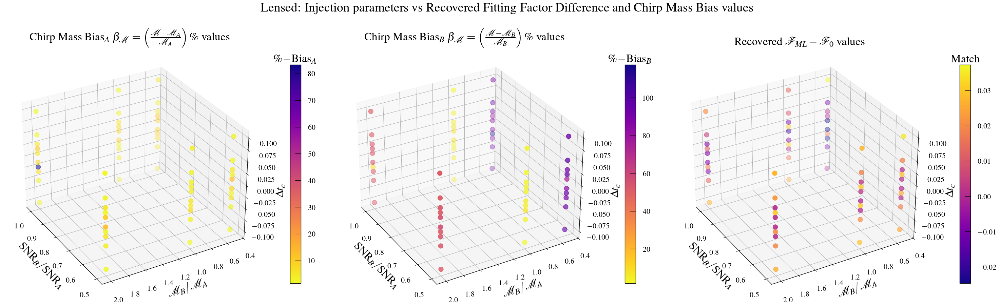

In [ ]:
fig, axes = plt.subplots(1, 3, figsize=(30, 10), subplot_kw={'projection': '3d'})

scatter1 = axes[0].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=bias_mchirp_a_ml, edgecolor=None, cmap='plasma_r', s=100)
clb1 = fig.colorbar(scatter1, ax=axes[0], shrink=0.7, pad=0.1)
clb1.ax.set_title('$\\%-$Bias$_A$')
clb1.ax.ticklabel_format(useOffset=False, style='plain')

axes[0].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[0].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[0].set_zlabel('$\Delta t_c$')
axes[0].set_title('Chirp Mass Bias$_A$ $\\beta_{\\mathcal{M}}=\\left(\\frac{\\mathcal{M}-\\mathcal{M}_A}{\\mathcal{M}_A}\\right)\\%$ values', loc='center')
axes[0].ticklabel_format(useOffset=False, style='plain')
axes[0].azim = 150

scatter2 = axes[1].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=bias_mchirp_b_ml, edgecolor=None, cmap='plasma_r', s=100)
clb2 = fig.colorbar(scatter2, ax=axes[1], shrink=0.7, pad=0.1)
clb2.ax.set_title('$\\%-$Bias$_B$')
clb2.ax.ticklabel_format(useOffset=False, style='plain')

axes[1].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[1].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[1].set_zlabel('$\Delta t_c$')
axes[1].set_title('Chirp Mass Bias$_B$ $\\beta_{\\mathcal{M}}=\\left(\\frac{\\mathcal{M}-\\mathcal{M}_B}{\\mathcal{M}_B}\\right)\\%$ values', loc='center')
axes[1].ticklabel_format(useOffset=False, style='plain')
axes[1].azim = 150

scatter3 = axes[2].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=match_ml-match, edgecolor=None, cmap='plasma', s=100)
clb3 = fig.colorbar(scatter3, ax=axes[2], shrink=0.7, pad=0.1)
clb3.ax.set_title('Match')
clb3.ax.ticklabel_format(useOffset=False, style='plain')

axes[2].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[2].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[2].set_zlabel('$\Delta t_c$')
axes[2].set_title('Recovered $\mathcal{F}_{{ML}}-\mathcal{F}_0$ values', loc='center')
axes[2].ticklabel_format(useOffset=False, style='plain')
axes[2].azim = 150

fig.suptitle('Lensed: Injection parameters vs Recovered Fitting Factor Difference and Chirp Mass Bias values')
plt.tight_layout()
plt.savefig('../../output/pe_population_3G/match/LENS_DIFF_BIAS_MCHIRP(3D).png')
plt.show()

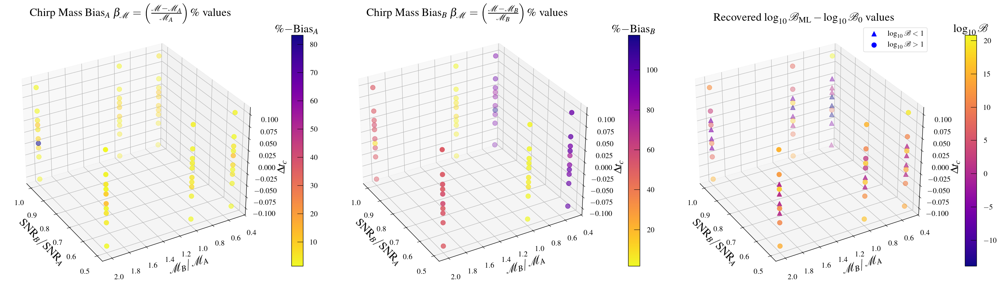

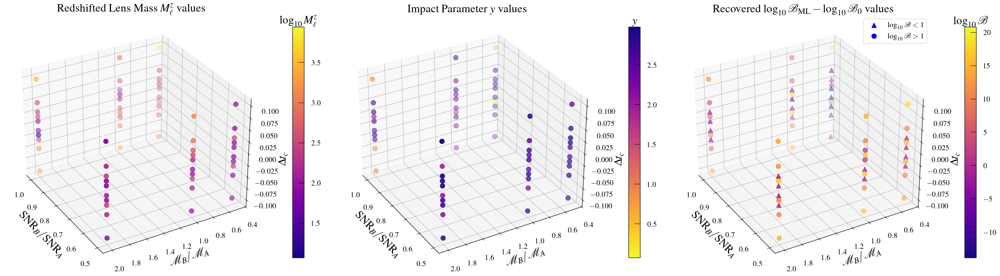

In [ ]:
fig, axes = plt.subplots(1, 3, figsize=(30, 10), subplot_kw={'projection': '3d'})

scatter1 = axes[0].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=bias_mchirp_a_ml, edgecolor=None, cmap='plasma_r', s=100)
clb1 = fig.colorbar(scatter1, ax=axes[0], shrink=0.7, pad=0.1)
clb1.ax.set_title('$\\%-$Bias$_A$')
clb1.ax.ticklabel_format(useOffset=False, style='plain')

axes[0].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[0].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[0].set_zlabel('$\Delta t_c$')
axes[0].set_title('Chirp Mass Bias$_A$ $\\beta_{\\mathcal{M}}=\\left(\\frac{\\mathcal{M}-\\mathcal{M}_A}{\\mathcal{M}_A}\\right)\\%$ values', loc='center')
axes[0].ticklabel_format(useOffset=False, style='plain')
axes[0].azim = 150

scatter2 = axes[1].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=bias_mchirp_b_ml, edgecolor=None, cmap='plasma_r', s=100)
clb2 = fig.colorbar(scatter2, ax=axes[1], shrink=0.7, pad=0.1)
clb2.ax.set_title('$\\%-$Bias$_B$')
clb2.ax.ticklabel_format(useOffset=False, style='plain')

axes[1].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[1].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[1].set_zlabel('$\Delta t_c$')
axes[1].set_title('Chirp Mass Bias$_B$ $\\beta_{\\mathcal{M}}=\\left(\\frac{\\mathcal{M}-\\mathcal{M}_B}{\\mathcal{M}_B}\\right)\\%$ values', loc='center')
axes[1].ticklabel_format(useOffset=False, style='plain')
axes[1].azim = 150

log_bayes_factor_ml_diff = snr_a**2*(match_ml**2-match**2)/2

diff_greater_1 = np.where(log_bayes_factor_ml_diff > 1)
diff_0_1 = np.where(log_bayes_factor_ml_diff <= 1)

scatter3 = axes[2].scatter(snr_b[diff_greater_1]/snr_a[diff_greater_1], mchirp_b[diff_greater_1]/mchirp_a[diff_greater_1], delta_tc[diff_greater_1], c=log_bayes_factor_ml_diff[diff_greater_1], edgecolor=None, cmap='plasma', s=100, marker='o', vmin=np.min(log_bayes_factor_ml_diff), vmax=np.max(log_bayes_factor_ml_diff))
scatter5 = axes[2].scatter(snr_b[diff_0_1]/snr_a[diff_0_1], mchirp_b[diff_0_1]/mchirp_a[diff_0_1], delta_tc[diff_0_1], c=log_bayes_factor_ml_diff[diff_0_1], edgecolor=None, cmap='plasma', s=100, marker='^', vmin=np.min(log_bayes_factor_ml_diff), vmax=np.max(log_bayes_factor_ml_diff))
clb3 = fig.colorbar(scatter3, ax=axes[2], shrink=0.7, pad=0.1)
clb3.ax.set_title('$\\log_{10}\\mathcal{B}$')
clb3.ax.ticklabel_format(useOffset=False, style='plain')

axes[2].scatter([], [], c='b', s=100, marker='^', label='$\\log_{10}\\mathcal{B} < 1$')
axes[2].scatter([], [], c='b', s=100, marker='o', label='$\\log_{10}\\mathcal{B} > 1$')
axes[2].legend(loc='upper right')

axes[2].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[2].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[2].set_zlabel('$\Delta t_c$')
axes[2].set_title('Recovered $\log_{10}\mathcal{B}_{\mathrm{ML}}-\log_{10}\mathcal{B}_{0}$ values', loc='center')
axes[2].ticklabel_format(useOffset=False, style='plain')
axes[2].azim = 150

plt.tight_layout()
plt.savefig('../../output/pe_population_3G/match/MicrolensedFFPE.pdf', dpi=600, bbox_inches='tight')
plt.show()
plt.close()

fig, axes = plt.subplots(1, 3, figsize=(30, 10), subplot_kw={'projection': '3d'})

scatter1 = axes[0].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=np.log10(Ml_z_ml), edgecolor=None, cmap='plasma', s=100)
clb1 = fig.colorbar(scatter1, ax=axes[0], shrink=0.7, pad=0.1)
clb1.ax.set_title('$\\log_{10} M_{\ell}^z$')

axes[0].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[0].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[0].set_zlabel('$\Delta t_c$')
axes[0].set_title('Redshifted Lens Mass $M_{\ell}^z$ values', loc='center')
axes[0].ticklabel_format(useOffset=False, style='plain')
axes[0].azim = 150

scatter2 = axes[1].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=y_ml, edgecolor=None, cmap='plasma_r', s=100)
clb2 = fig.colorbar(scatter2, ax=axes[1], shrink=0.7, pad=0.1)
clb2.ax.set_title('$y$')

axes[1].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[1].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[1].set_zlabel('$\Delta t_c$')
axes[1].set_title('Impact Parameter $y$ values', loc='center')
axes[1].ticklabel_format(useOffset=False, style='plain')
axes[1].azim = 150

scatter3 = axes[2].scatter(snr_b[diff_greater_1]/snr_a[diff_greater_1], mchirp_b[diff_greater_1]/mchirp_a[diff_greater_1], delta_tc[diff_greater_1], c=log_bayes_factor_ml_diff[diff_greater_1], edgecolor=None, cmap='plasma', s=100, marker='o', vmin=np.min(log_bayes_factor_ml_diff), vmax=np.max(log_bayes_factor_ml_diff))
scatter5 = axes[2].scatter(snr_b[diff_0_1]/snr_a[diff_0_1], mchirp_b[diff_0_1]/mchirp_a[diff_0_1], delta_tc[diff_0_1], c=log_bayes_factor_ml_diff[diff_0_1], edgecolor=None, cmap='plasma', s=100, marker='^', vmin=np.min(log_bayes_factor_ml_diff), vmax=np.max(log_bayes_factor_ml_diff))
clb3 = fig.colorbar(scatter3, ax=axes[2], shrink=0.7, pad=0.1)
clb3.ax.set_title('$\log_{10}\mathcal{B}$')
clb3.ax.ticklabel_format(useOffset=False, style='plain')

axes[2].scatter([], [], c='b', s=100, marker='^', label='$\\log_{10}\\mathcal{B} < 1$')
axes[2].scatter([], [], c='b', s=100, marker='o', label='$\\log_{10}\\mathcal{B} > 1$')
axes[2].legend(loc='upper right')

axes[2].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[2].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[2].set_zlabel('$\Delta t_c$')
axes[2].set_title('Recovered $\log_{10}\mathcal{B}_{\mathrm{ML}}-\log_{10}\mathcal{B}_{0}$ values', loc='center')
axes[2].ticklabel_format(useOffset=False, style='plain')
axes[2].azim = 150

plt.tight_layout()
plt.savefig('../../output/pe_population_3G/match/MicrolensedFFParameters.pdf', dpi=600, bbox_inches='tight')
plt.show()
plt.close()

### Type II Lensed

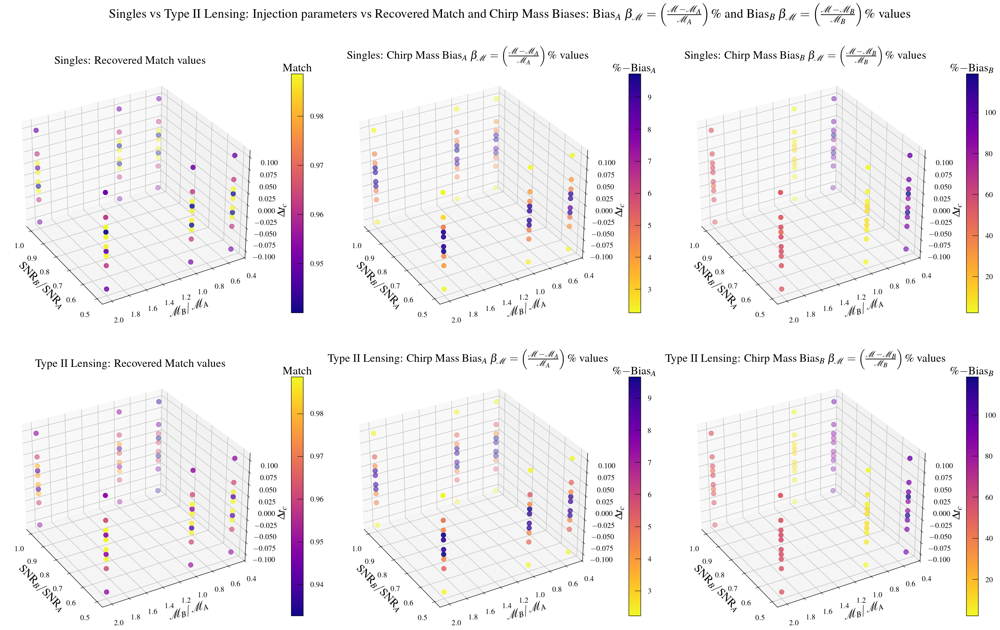

In [ ]:
fig, axes = plt.subplots(2, 3, figsize=(30, 20), subplot_kw={'projection': '3d'})

scatter1 = axes[0,0].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=match, edgecolor=None, cmap='plasma', s=100)
clb0 = fig.colorbar(scatter1, ax=axes[0,0], shrink=0.7, pad=0.1)
clb0.ax.set_title('Match')
clb0.ax.ticklabel_format(useOffset=False, style='plain')

axes[0,0].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[0,0].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[0,0].set_zlabel('$\Delta t_c$')
axes[0,0].ticklabel_format(useOffset=False, style='plain')
axes[0,0].azim = 150

axes[0,0].set_title('Singles: Recovered Match values', loc='center')

ax1 = axes[0,1].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=bias_mchirp_a, cmap='plasma_r', s=100)
clb1 = plt.colorbar(ax1, ax=axes[0,1], shrink=0.7, norm=None, pad=0.1)
clb1.ax.set_title('$\\%-$Bias$_A$')
clb1.ax.ticklabel_format(useOffset=False, style='plain')

axes[0,1].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[0,1].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[0,1].set_zlabel('$\Delta t_c$')
axes[0,1].ticklabel_format(useOffset=False, style='plain')
axes[0,1].azim = 150

axes[0,1].set_title('Singles: Chirp Mass Bias$_A$ $\\beta_{\\mathcal{M}}=\\left(\\frac{\\mathcal{M}-\\mathcal{M}_A}{\\mathcal{M}_A}\\right)\\%$ values', loc='center')

ax2 = axes[0,2].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=bias_mchirp_b, cmap='plasma_r', s=100)
clb2 = plt.colorbar(ax2, ax=axes[0,2], shrink=0.7, norm=None, pad=0.1)
clb2.ax.set_title('$\\%-$Bias$_B$')
clb2.ax.ticklabel_format(useOffset=False, style='plain')

axes[0,2].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[0,2].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[0,2].set_zlabel('$\Delta t_c$')
axes[0,2].ticklabel_format(useOffset=False, style='plain')
axes[0,2].azim = 150

axes[0,2].set_title('Singles: Chirp Mass Bias$_B$ $\\beta_{\\mathcal{M}}=\\left(\\frac{\\mathcal{M}-\\mathcal{M}_B}{\\mathcal{M}_B}\\right)\\%$ values', loc='center')

scatter2 = axes[1,0].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=match_ml2, edgecolor=None, cmap='plasma', s=100)
clb2 = fig.colorbar(scatter2, ax=axes[1,0], shrink=0.7, pad=0.1)
clb2.ax.set_title('Match')
clb2.ax.ticklabel_format(useOffset=False, style='plain')

axes[1,0].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[1,0].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[1,0].set_zlabel('$\Delta t_c$')
axes[1,0].ticklabel_format(useOffset=False, style='plain')
axes[1,0].azim = 150

axes[1,0].set_title('Type II Lensing: Recovered Match values', loc='center')

ax3 = axes[1,1].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=bias_mchirp_a_ml2, cmap='plasma_r', s=100)
clb3 = plt.colorbar(ax3, ax=axes[1,1], shrink=0.7, norm=None, pad=0.1)
clb3.ax.set_title('$\\%-$Bias$_A$')
clb3.ax.ticklabel_format(useOffset=False, style='plain')

axes[1,1].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[1,1].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[1,1].set_zlabel('$\Delta t_c$')
axes[1,1].ticklabel_format(useOffset=False, style='plain')
axes[1,1].azim = 150

axes[1,1].set_title('Type II Lensing: Chirp Mass Bias$_A$ $\\beta_{\\mathcal{M}}=\\left(\\frac{\\mathcal{M}-\\mathcal{M}_A}{\\mathcal{M}_A}\\right)\\%$ values', loc='center')

ax4 = axes[1,2].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=bias_mchirp_b_ml2, cmap='plasma_r', s=100)
clb4 = plt.colorbar(ax4, ax=axes[1,2], shrink=0.7, norm=None, pad=0.1)
clb4.ax.set_title('$\\%-$Bias$_B$')
clb4.ax.ticklabel_format(useOffset=False, style='plain')

axes[1,2].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[1,2].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[1,2].set_zlabel('$\Delta t_c$')
axes[1,2].ticklabel_format(useOffset=False, style='plain')
axes[1,2].azim = 150

axes[1,2].set_title('Type II Lensing: Chirp Mass Bias$_B$ $\\beta_{\\mathcal{M}}=\\left(\\frac{\\mathcal{M}-\\mathcal{M}_B}{\\mathcal{M}_B}\\right)\\%$ values', loc='center')

fig.suptitle('Singles vs Type II Lensing: Injection parameters vs Recovered Match and Chirp Mass Biases: Bias$_A$ $\\beta_{\\mathcal{M}}=\\left(\\frac{\\mathcal{M}-\\mathcal{M}_A}{\\mathcal{M}_A}\\right)\\%$ and Bias$_B$ $\\beta_{\\mathcal{M}}=\\left(\\frac{\\mathcal{M}-\\mathcal{M}_B}{\\mathcal{M}_B}\\right)\\%$ values')
plt.tight_layout()
plt.savefig('../../output/pe_population_3G/match/SL2_COMPARISION.png')
plt.show()

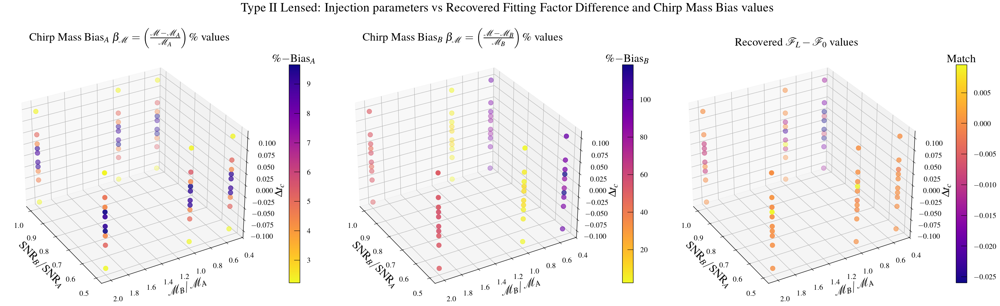

In [ ]:
fig, axes = plt.subplots(1, 3, figsize=(30, 10), subplot_kw={'projection': '3d'})

scatter1 = axes[0].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=bias_mchirp_a_ml2, edgecolor=None, cmap='plasma_r', s=100)
clb1 = fig.colorbar(scatter1, ax=axes[0], shrink=0.7, pad=0.1)
clb1.ax.set_title('$\\%-$Bias$_A$')
clb1.ax.ticklabel_format(useOffset=False, style='plain')

axes[0].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[0].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[0].set_zlabel('$\Delta t_c$')
axes[0].set_title('Chirp Mass Bias$_A$ $\\beta_{\\mathcal{M}}=\\left(\\frac{\\mathcal{M}-\\mathcal{M}_A}{\\mathcal{M}_A}\\right)\\%$ values', loc='center')
axes[0].ticklabel_format(useOffset=False, style='plain')
axes[0].azim = 150

scatter2 = axes[1].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=bias_mchirp_b_ml2, edgecolor=None, cmap='plasma_r', s=100)
clb2 = fig.colorbar(scatter2, ax=axes[1], shrink=0.7, pad=0.1)
clb2.ax.set_title('$\\%-$Bias$_B$')
clb2.ax.ticklabel_format(useOffset=False, style='plain')

axes[1].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[1].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[1].set_zlabel('$\Delta t_c$')
axes[1].set_title('Chirp Mass Bias$_B$ $\\beta_{\\mathcal{M}}=\\left(\\frac{\\mathcal{M}-\\mathcal{M}_B}{\\mathcal{M}_B}\\right)\\%$ values', loc='center')
axes[1].ticklabel_format(useOffset=False, style='plain')
axes[1].azim = 150

scatter3 = axes[2].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=match_ml2-match, edgecolor=None, cmap='plasma', s=100)
clb3 = fig.colorbar(scatter3, ax=axes[2], shrink=0.7, pad=0.1)
clb3.ax.set_title('Match')
clb3.ax.ticklabel_format(useOffset=False, style='plain')

axes[2].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[2].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[2].set_zlabel('$\Delta t_c$')
axes[2].set_title('Recovered $\mathcal{F}_{{L}}-\mathcal{F}_0$ values', loc='center')
axes[2].ticklabel_format(useOffset=False, style='plain')
axes[2].azim = 150

fig.suptitle('Type II Lensed: Injection parameters vs Recovered Fitting Factor Difference and Chirp Mass Bias values')
plt.tight_layout()
plt.savefig('../../output/pe_population_3G/match/SL2_DIFF_BIAS_MCHIRP(3D).png')
plt.show()

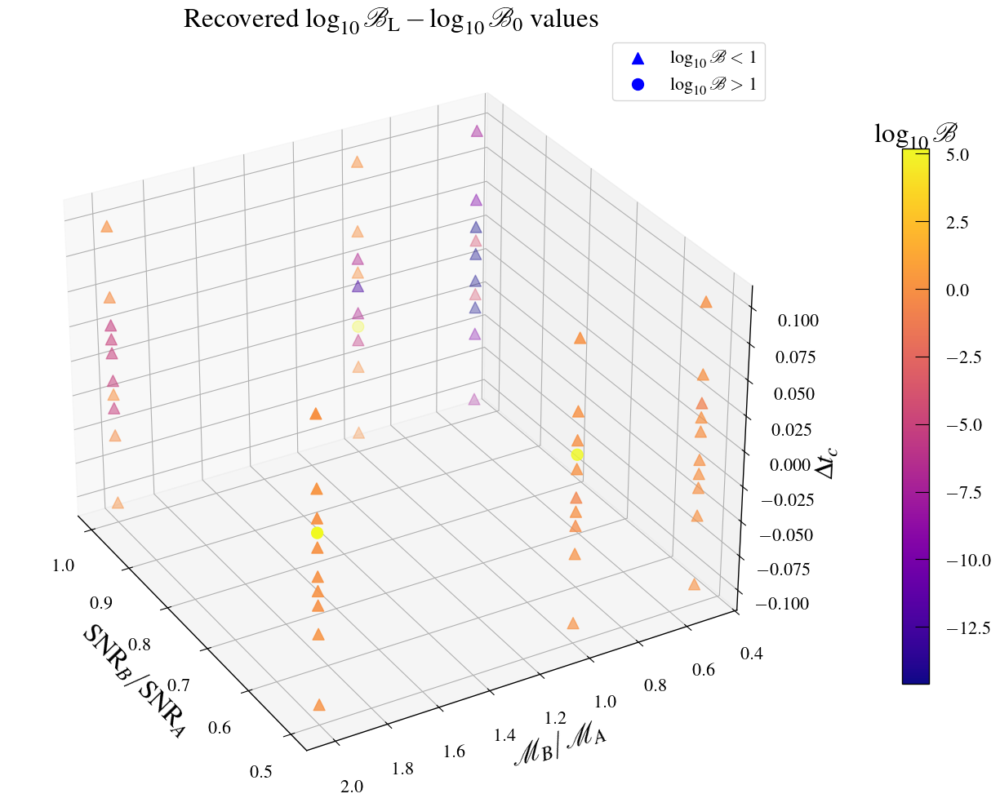

In [ ]:
fig, axes = plt.subplots(1, 1, figsize=(16, 10), subplot_kw={'projection': '3d'})

log_bayes_factor_ml2_diff = snr_a**2*(match_ml2**2-match**2)/2

diff_greater_1 = np.where(log_bayes_factor_ml2_diff > 1)
diff_0_1 = np.where(log_bayes_factor_ml2_diff <= 1)

scatter3 = axes.scatter(snr_b[diff_greater_1]/snr_a[diff_greater_1], mchirp_b[diff_greater_1]/mchirp_a[diff_greater_1], delta_tc[diff_greater_1], c=log_bayes_factor_ml2_diff[diff_greater_1], edgecolor=None, cmap='plasma', s=100, marker='o', vmin=np.min(log_bayes_factor_ml2_diff), vmax=np.max(log_bayes_factor_ml2_diff))
scatter5 = axes.scatter(snr_b[diff_0_1]/snr_a[diff_0_1], mchirp_b[diff_0_1]/mchirp_a[diff_0_1], delta_tc[diff_0_1], c=log_bayes_factor_ml2_diff[diff_0_1], edgecolor=None, cmap='plasma', s=100, marker='^', vmin=np.min(log_bayes_factor_ml2_diff), vmax=np.max(log_bayes_factor_ml2_diff))
clb3 = fig.colorbar(scatter3, ax=axes, shrink=0.7, pad=0.1)
clb3.ax.set_title('$\\log_{10}\\mathcal{B}$')
clb3.ax.ticklabel_format(useOffset=False, style='plain')

axes.scatter([], [], c='b', s=100, marker='^', label='$\\log_{10}\\mathcal{B} < 1$')
axes.scatter([], [], c='b', s=100, marker='o', label='$\\log_{10}\\mathcal{B} > 1$')
axes.legend(loc='upper right')

axes.set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes.set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes.set_zlabel('$\Delta t_c$')
axes.set_title('Recovered $\log_{10}\mathcal{B}_{\mathrm{L}}-\log_{10}\mathcal{B}_{0}$ values', loc='center')
axes.ticklabel_format(useOffset=False, style='plain')
axes.azim = 150

plt.tight_layout()
plt.savefig('../../output/pe_population_3G/match/SL2FFPE.pdf', dpi=600, bbox_inches='tight')
plt.show()
plt.close()

### Type II Lensing (C)

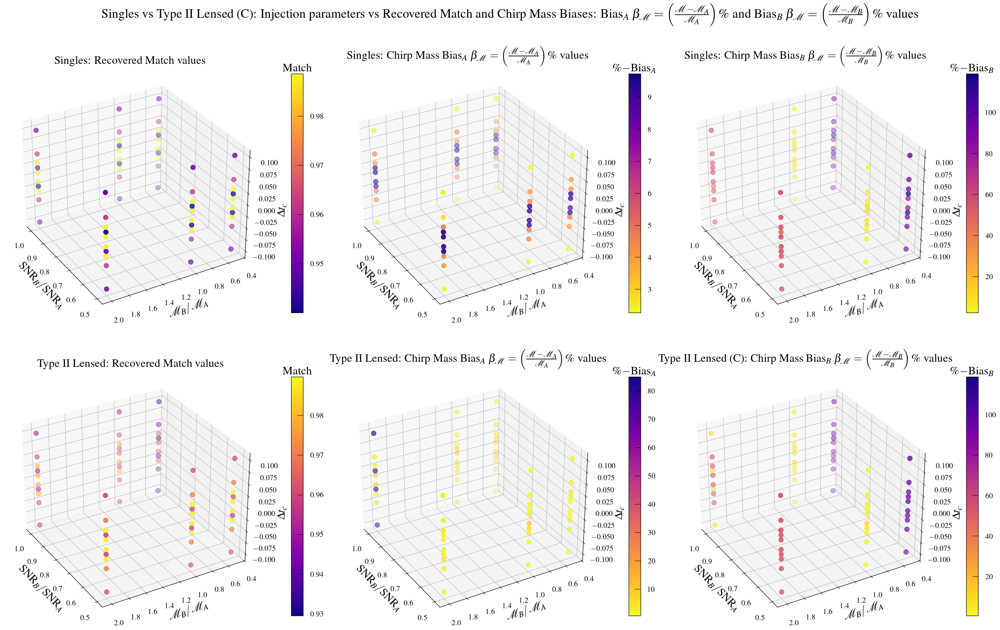

In [ ]:
fig, axes = plt.subplots(2, 3, figsize=(30, 20), subplot_kw={'projection': '3d'})

scatter1 = axes[0,0].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=match, edgecolor=None, cmap='plasma', s=100)
clb0 = fig.colorbar(scatter1, ax=axes[0,0], shrink=0.7, pad=0.1)
clb0.ax.set_title('Match')
clb0.ax.ticklabel_format(useOffset=False, style='plain')

axes[0,0].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[0,0].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[0,0].set_zlabel('$\Delta t_c$')
axes[0,0].ticklabel_format(useOffset=False, style='plain')
axes[0,0].azim = 150

axes[0,0].set_title('Singles: Recovered Match values', loc='center')

ax1 = axes[0,1].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=bias_mchirp_a, cmap='plasma_r', s=100)
clb1 = plt.colorbar(ax1, ax=axes[0,1], shrink=0.7, norm=None, pad=0.1)
clb1.ax.set_title('$\\%-$Bias$_A$')
clb1.ax.ticklabel_format(useOffset=False, style='plain')

axes[0,1].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[0,1].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[0,1].set_zlabel('$\Delta t_c$')
axes[0,1].ticklabel_format(useOffset=False, style='plain')
axes[0,1].azim = 150

axes[0,1].set_title('Singles: Chirp Mass Bias$_A$ $\\beta_{\\mathcal{M}}=\\left(\\frac{\\mathcal{M}-\\mathcal{M}_A}{\\mathcal{M}_A}\\right)\\%$ values', loc='center')

ax2 = axes[0,2].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=bias_mchirp_b, cmap='plasma_r', s=100)
clb2 = plt.colorbar(ax2, ax=axes[0,2], shrink=0.7, norm=None, pad=0.1)
clb2.ax.set_title('$\\%-$Bias$_B$')
clb2.ax.ticklabel_format(useOffset=False, style='plain')

axes[0,2].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[0,2].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[0,2].set_zlabel('$\Delta t_c$')
axes[0,2].ticklabel_format(useOffset=False, style='plain')
axes[0,2].azim = 150

axes[0,2].set_title('Singles: Chirp Mass Bias$_B$ $\\beta_{\\mathcal{M}}=\\left(\\frac{\\mathcal{M}-\\mathcal{M}_B}{\\mathcal{M}_B}\\right)\\%$ values', loc='center')

scatter2 = axes[1,0].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=match_ml2c, edgecolor=None, cmap='plasma', s=100)
clb2 = fig.colorbar(scatter2, ax=axes[1,0], shrink=0.7, pad=0.1)
clb2.ax.set_title('Match')
clb2.ax.ticklabel_format(useOffset=False, style='plain')

axes[1,0].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[1,0].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[1,0].set_zlabel('$\Delta t_c$')
axes[1,0].ticklabel_format(useOffset=False, style='plain')
axes[1,0].azim = 150

axes[1,0].set_title('Type II Lensed: Recovered Match values', loc='center')

ax3 = axes[1,1].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=bias_mchirp_a_ml2c, cmap='plasma_r', s=100)
clb3 = plt.colorbar(ax3, ax=axes[1,1], shrink=0.7, norm=None, pad=0.1)
clb3.ax.set_title('$\\%-$Bias$_A$')
clb3.ax.ticklabel_format(useOffset=False, style='plain')

axes[1,1].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[1,1].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[1,1].set_zlabel('$\Delta t_c$')
axes[1,1].ticklabel_format(useOffset=False, style='plain')
axes[1,1].azim = 150

axes[1,1].set_title('Type II Lensed: Chirp Mass Bias$_A$ $\\beta_{\\mathcal{M}}=\\left(\\frac{\\mathcal{M}-\\mathcal{M}_A}{\\mathcal{M}_A}\\right)\\%$ values', loc='center')

ax4 = axes[1,2].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=bias_mchirp_b_ml2c, cmap='plasma_r', s=100)
clb4 = plt.colorbar(ax4, ax=axes[1,2], shrink=0.7, norm=None, pad=0.1)
clb4.ax.set_title('$\\%-$Bias$_B$')
clb4.ax.ticklabel_format(useOffset=False, style='plain')

axes[1,2].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[1,2].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[1,2].set_zlabel('$\Delta t_c$')
axes[1,2].ticklabel_format(useOffset=False, style='plain')
axes[1,2].azim = 150

axes[1,2].set_title('Type II Lensed (C): Chirp Mass Bias$_B$ $\\beta_{\\mathcal{M}}=\\left(\\frac{\\mathcal{M}-\\mathcal{M}_B}{\\mathcal{M}_B}\\right)\\%$ values', loc='center')

fig.suptitle('Singles vs Type II Lensed (C): Injection parameters vs Recovered Match and Chirp Mass Biases: Bias$_A$ $\\beta_{\\mathcal{M}}=\\left(\\frac{\\mathcal{M}-\\mathcal{M}_A}{\\mathcal{M}_A}\\right)\\%$ and Bias$_B$ $\\beta_{\\mathcal{M}}=\\left(\\frac{\\mathcal{M}-\\mathcal{M}_B}{\\mathcal{M}_B}\\right)\\%$ values')
plt.tight_layout()
plt.savefig('../../output/pe_population_3G/match/SL2C_COMPARISION.png')
plt.show()

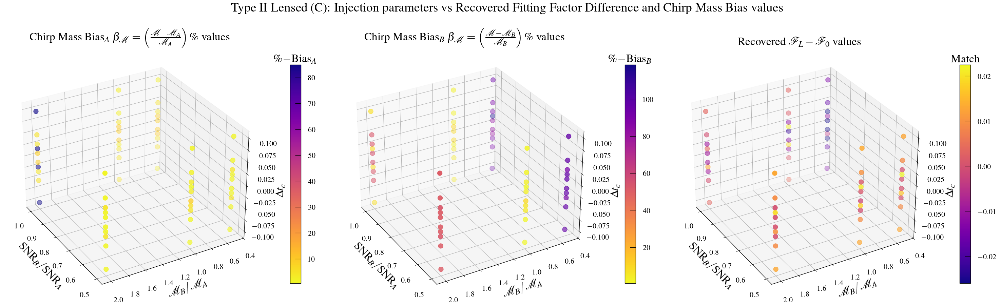

In [ ]:
fig, axes = plt.subplots(1, 3, figsize=(30, 10), subplot_kw={'projection': '3d'})

scatter1 = axes[0].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=bias_mchirp_a_ml2c, edgecolor=None, cmap='plasma_r', s=100)
clb1 = fig.colorbar(scatter1, ax=axes[0], shrink=0.7, pad=0.1)
clb1.ax.set_title('$\\%-$Bias$_A$')
clb1.ax.ticklabel_format(useOffset=False, style='plain')

axes[0].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[0].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[0].set_zlabel('$\Delta t_c$')
axes[0].set_title('Chirp Mass Bias$_A$ $\\beta_{\\mathcal{M}}=\\left(\\frac{\\mathcal{M}-\\mathcal{M}_A}{\\mathcal{M}_A}\\right)\\%$ values', loc='center')
axes[0].ticklabel_format(useOffset=False, style='plain')
axes[0].azim = 150

scatter2 = axes[1].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=bias_mchirp_b_ml2c, edgecolor=None, cmap='plasma_r', s=100)
clb2 = fig.colorbar(scatter2, ax=axes[1], shrink=0.7, pad=0.1)
clb2.ax.set_title('$\\%-$Bias$_B$')
clb2.ax.ticklabel_format(useOffset=False, style='plain')

axes[1].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[1].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[1].set_zlabel('$\Delta t_c$')
axes[1].set_title('Chirp Mass Bias$_B$ $\\beta_{\\mathcal{M}}=\\left(\\frac{\\mathcal{M}-\\mathcal{M}_B}{\\mathcal{M}_B}\\right)\\%$ values', loc='center')
axes[1].ticklabel_format(useOffset=False, style='plain')
axes[1].azim = 150

scatter3 = axes[2].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=match_ml2c-match, edgecolor=None, cmap='plasma', s=100)
clb3 = fig.colorbar(scatter3, ax=axes[2], shrink=0.7, pad=0.1)
clb3.ax.set_title('Match')
clb3.ax.ticklabel_format(useOffset=False, style='plain')

axes[2].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[2].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[2].set_zlabel('$\Delta t_c$')
axes[2].set_title('Recovered $\mathcal{F}_{{L}}-\mathcal{F}_0$ values', loc='center')
axes[2].ticklabel_format(useOffset=False, style='plain')
axes[2].azim = 150

fig.suptitle('Type II Lensed (C): Injection parameters vs Recovered Fitting Factor Difference and Chirp Mass Bias values')
plt.tight_layout()
plt.savefig('../../output/pe_population_3G/match/SL2C_DIFF_BIAS_MCHIRP(3D).png')
plt.show()

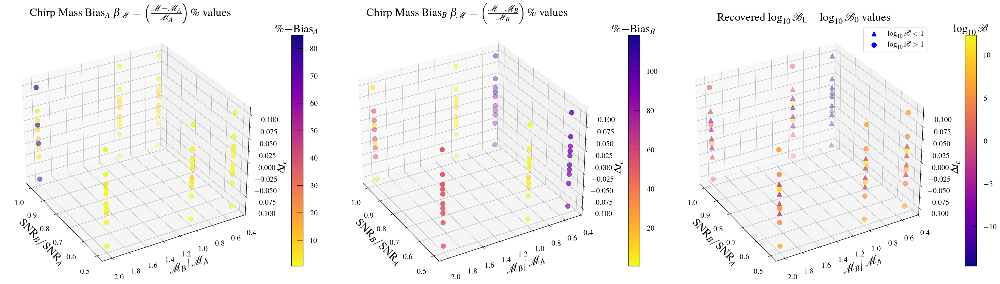

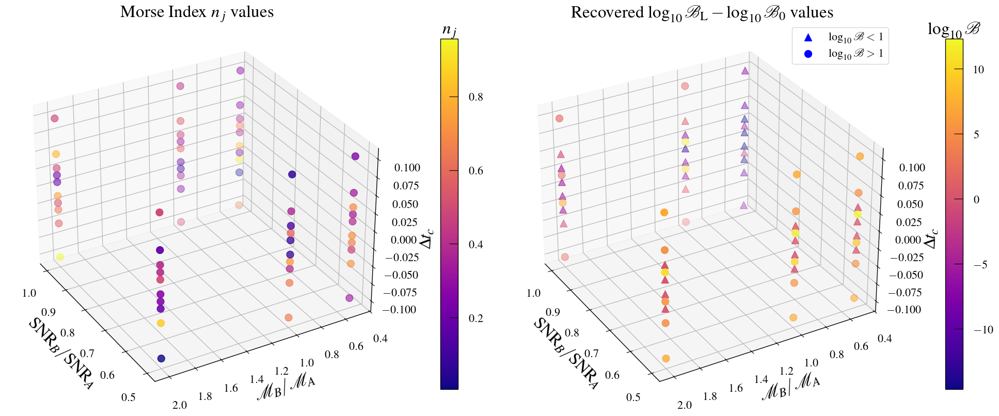

In [ ]:
fig, axes = plt.subplots(1, 3, figsize=(30, 10), subplot_kw={'projection': '3d'})

scatter1 = axes[0].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=bias_mchirp_a_ml2c, edgecolor=None, cmap='plasma_r', s=100)
clb1 = fig.colorbar(scatter1, ax=axes[0], shrink=0.7, pad=0.1)
clb1.ax.set_title('$\\%-$Bias$_A$')
clb1.ax.ticklabel_format(useOffset=False, style='plain')

axes[0].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[0].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[0].set_zlabel('$\Delta t_c$')
axes[0].set_title('Chirp Mass Bias$_A$ $\\beta_{\\mathcal{M}}=\\left(\\frac{\\mathcal{M}-\\mathcal{M}_A}{\\mathcal{M}_A}\\right)\\%$ values', loc='center')
axes[0].ticklabel_format(useOffset=False, style='plain')
axes[0].azim = 150

scatter2 = axes[1].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=bias_mchirp_b_ml2c, edgecolor=None, cmap='plasma_r', s=100)
clb2 = fig.colorbar(scatter2, ax=axes[1], shrink=0.7, pad=0.1)
clb2.ax.set_title('$\\%-$Bias$_B$')
clb2.ax.ticklabel_format(useOffset=False, style='plain')

axes[1].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[1].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[1].set_zlabel('$\Delta t_c$')
axes[1].set_title('Chirp Mass Bias$_B$ $\\beta_{\\mathcal{M}}=\\left(\\frac{\\mathcal{M}-\\mathcal{M}_B}{\\mathcal{M}_B}\\right)\\%$ values', loc='center')
axes[1].ticklabel_format(useOffset=False, style='plain')
axes[1].azim = 150

log_bayes_factor_ml2c_diff = snr_a**2*(match_ml2c**2-match**2)/2

diff_greater_1 = np.where(log_bayes_factor_ml2c_diff > 1)
diff_0_1 = np.where(log_bayes_factor_ml2c_diff <= 1)

scatter3 = axes[2].scatter(snr_b[diff_greater_1]/snr_a[diff_greater_1], mchirp_b[diff_greater_1]/mchirp_a[diff_greater_1], delta_tc[diff_greater_1], c=log_bayes_factor_ml2c_diff[diff_greater_1], edgecolor=None, cmap='plasma', s=100, marker='o', vmin=np.min(log_bayes_factor_ml2c_diff), vmax=np.max(log_bayes_factor_ml2c_diff))
scatter5 = axes[2].scatter(snr_b[diff_0_1]/snr_a[diff_0_1], mchirp_b[diff_0_1]/mchirp_a[diff_0_1], delta_tc[diff_0_1], c=log_bayes_factor_ml2c_diff[diff_0_1], edgecolor=None, cmap='plasma', s=100, marker='^', vmin=np.min(log_bayes_factor_ml2c_diff), vmax=np.max(log_bayes_factor_ml2c_diff))
clb3 = fig.colorbar(scatter3, ax=axes[2], shrink=0.7, pad=0.1)
clb3.ax.set_title('$\\log_{10}\\mathcal{B}$')
clb3.ax.ticklabel_format(useOffset=False, style='plain')

axes[2].scatter([], [], c='b', s=100, marker='^', label='$\\log_{10}\\mathcal{B} < 1$')
axes[2].scatter([], [], c='b', s=100, marker='o', label='$\\log_{10}\\mathcal{B} > 1$')
axes[2].legend(loc='upper right')

axes[2].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[2].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[2].set_zlabel('$\Delta t_c$')
axes[2].set_title('Recovered $\log_{10}\mathcal{B}_{\mathrm{L}}-\log_{10}\mathcal{B}_{0}$ values', loc='center')
axes[2].ticklabel_format(useOffset=False, style='plain')
axes[2].azim = 150

plt.tight_layout()
plt.savefig('../../output/pe_population_3G/match/SL2CFFPE.pdf', dpi=600, bbox_inches='tight')
plt.show()
plt.close()

fig, axes = plt.subplots(1, 2, figsize=(20, 10), subplot_kw={'projection': '3d'})

scatter1 = axes[0].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=n_ml2c, edgecolor=None, cmap='plasma', s=100)
clb1 = fig.colorbar(scatter1, ax=axes[0], shrink=0.7, pad=0.1)
clb1.ax.set_title('$n_j$')

axes[0].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[0].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[0].set_zlabel('$\Delta t_c$')
axes[0].set_title('Morse Index $n_j$ values', loc='center')
axes[0].ticklabel_format(useOffset=False, style='plain')
axes[0].azim = 150

scatter3 = axes[1].scatter(snr_b[diff_greater_1]/snr_a[diff_greater_1], mchirp_b[diff_greater_1]/mchirp_a[diff_greater_1], delta_tc[diff_greater_1], c=log_bayes_factor_ml2c_diff[diff_greater_1], edgecolor=None, cmap='plasma', s=100, marker='o', vmin=np.min(log_bayes_factor_ml2c_diff), vmax=np.max(log_bayes_factor_ml2c_diff))
scatter5 = axes[1].scatter(snr_b[diff_0_1]/snr_a[diff_0_1], mchirp_b[diff_0_1]/mchirp_a[diff_0_1], delta_tc[diff_0_1], c=log_bayes_factor_ml2c_diff[diff_0_1], edgecolor=None, cmap='plasma', s=100, marker='^', vmin=np.min(log_bayes_factor_ml2c_diff), vmax=np.max(log_bayes_factor_ml2c_diff))
clb3 = fig.colorbar(scatter3, ax=axes[1], shrink=0.7, pad=0.1)
clb3.ax.set_title('$\log_{10}\mathcal{B}$')
clb3.ax.ticklabel_format(useOffset=False, style='plain')

axes[1].scatter([], [], c='b', s=100, marker='^', label='$\\log_{10}\\mathcal{B} < 1$')
axes[1].scatter([], [], c='b', s=100, marker='o', label='$\\log_{10}\\mathcal{B} > 1$')
axes[1].legend(loc='upper right')

axes[1].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[1].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[1].set_zlabel('$\Delta t_c$')
axes[1].set_title('Recovered $\log_{10}\mathcal{B}_{\mathrm{L}}-\log_{10}\mathcal{B}_{0}$ values', loc='center')
axes[1].ticklabel_format(useOffset=False, style='plain')
axes[1].azim = 150

plt.tight_layout()
plt.savefig('../../output/pe_population_3G/match/SL2CFFParameters.pdf', dpi=600, bbox_inches='tight')
plt.show()
plt.close()

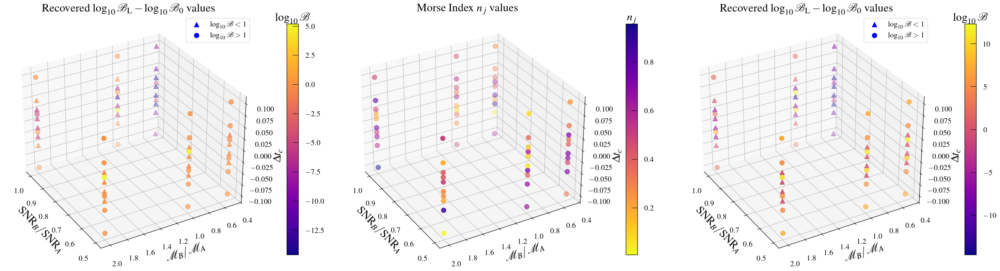

In [ ]:
fig, axes = plt.subplots(1, 3, figsize=(30, 10), subplot_kw={'projection': '3d'})

scatter3 = axes[0].scatter(snr_b[diff_greater_1]/snr_a[diff_greater_1], mchirp_b[diff_greater_1]/mchirp_a[diff_greater_1], delta_tc[diff_greater_1], c=log_bayes_factor_ml2_diff[diff_greater_1], edgecolor=None, cmap='plasma', s=100, marker='o', vmin=np.min(log_bayes_factor_ml2_diff), vmax=np.max(log_bayes_factor_ml2_diff))
scatter5 = axes[0].scatter(snr_b[diff_0_1]/snr_a[diff_0_1], mchirp_b[diff_0_1]/mchirp_a[diff_0_1], delta_tc[diff_0_1], c=log_bayes_factor_ml2_diff[diff_0_1], edgecolor=None, cmap='plasma', s=100, marker='^', vmin=np.min(log_bayes_factor_ml2_diff), vmax=np.max(log_bayes_factor_ml2_diff))
clb3 = fig.colorbar(scatter3, ax=axes[0], shrink=0.7, pad=0.1)
clb3.ax.set_title('$\\log_{10}\\mathcal{B}$')
clb3.ax.ticklabel_format(useOffset=False, style='plain')

axes[0].scatter([], [], c='b', s=100, marker='^', label='$\\log_{10}\\mathcal{B} < 1$')
axes[0].scatter([], [], c='b', s=100, marker='o', label='$\\log_{10}\\mathcal{B} > 1$')
axes[0].legend(loc='upper right')

axes[0].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[0].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[0].set_zlabel('$\Delta t_c$')
axes[0].set_title('Recovered $\log_{10}\mathcal{B}_{\mathrm{L}}-\log_{10}\mathcal{B}_{0}$ values', loc='center')
axes[0].ticklabel_format(useOffset=False, style='plain')
axes[0].azim = 150

scatter2 = axes[1].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=n_ml2c, edgecolor=None, cmap='plasma_r', s=100)
clb2 = fig.colorbar(scatter2, ax=axes[1], shrink=0.7, pad=0.1)
clb2.ax.set_title('$n_j$')
clb2.ax.ticklabel_format(useOffset=False, style='plain')

axes[1].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[1].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[1].set_zlabel('$\Delta t_c$')
axes[1].set_title('Morse Index $n_j$ values', loc='center')
axes[1].ticklabel_format(useOffset=False, style='plain')
axes[1].azim = 150

scatter3 = axes[2].scatter(snr_b[diff_greater_1]/snr_a[diff_greater_1], mchirp_b[diff_greater_1]/mchirp_a[diff_greater_1], delta_tc[diff_greater_1], c=log_bayes_factor_ml2c_diff[diff_greater_1], edgecolor=None, cmap='plasma', s=100, marker='o', vmin=np.min(log_bayes_factor_ml2c_diff), vmax=np.max(log_bayes_factor_ml2c_diff))
scatter5 = axes[2].scatter(snr_b[diff_0_1]/snr_a[diff_0_1], mchirp_b[diff_0_1]/mchirp_a[diff_0_1], delta_tc[diff_0_1], c=log_bayes_factor_ml2c_diff[diff_0_1], edgecolor=None, cmap='plasma', s=100, marker='^', vmin=np.min(log_bayes_factor_ml2c_diff), vmax=np.max(log_bayes_factor_ml2c_diff))
clb3 = fig.colorbar(scatter3, ax=axes[2], shrink=0.7, pad=0.1)
clb3.ax.set_title('$\\log_{10}\\mathcal{B}$')
clb3.ax.ticklabel_format(useOffset=False, style='plain')

axes[2].scatter([], [], c='b', s=100, marker='^', label='$\\log_{10}\\mathcal{B} < 1$')
axes[2].scatter([], [], c='b', s=100, marker='o', label='$\\log_{10}\\mathcal{B} > 1$')
axes[2].legend(loc='upper right')

axes[2].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[2].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[2].set_zlabel('$\Delta t_c$')
axes[2].set_title('Recovered $\log_{10}\mathcal{B}_{\mathrm{L}}-\log_{10}\mathcal{B}_{0}$ values', loc='center')
axes[2].ticklabel_format(useOffset=False, style='plain')
axes[2].azim = 150

plt.tight_layout()
plt.savefig('../../output/pe_population_3G/match/TypeIILensingFFPE.pdf', dpi=600, bbox_inches='tight')
plt.show()
plt.close()

### Eccentric

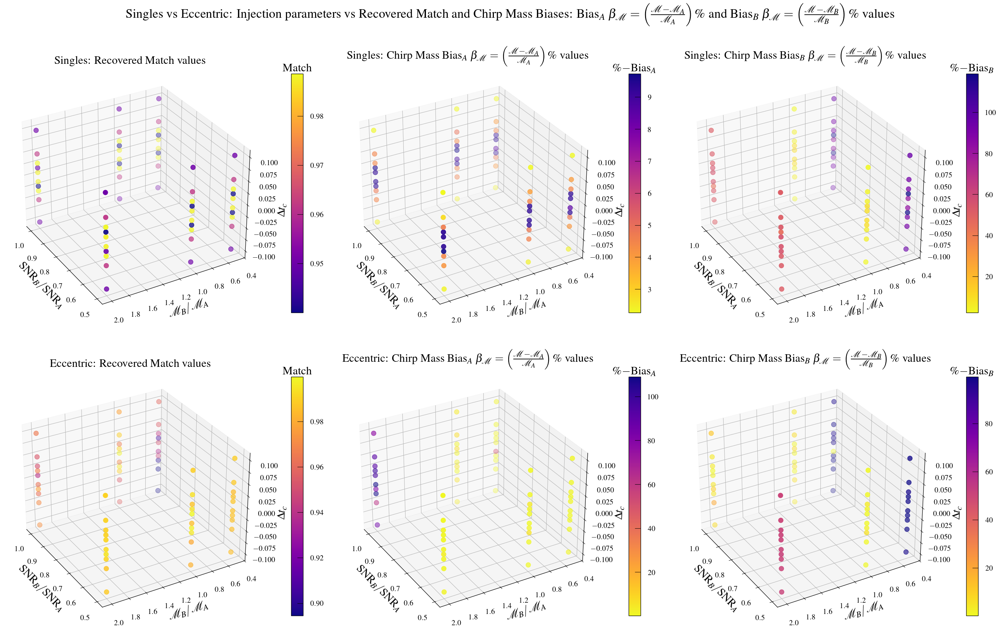

In [ ]:
fig, axes = plt.subplots(2, 3, figsize=(30, 20), subplot_kw={'projection': '3d'})

scatter1 = axes[0,0].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=match, edgecolor=None, cmap='plasma', s=100)
clb0 = fig.colorbar(scatter1, ax=axes[0,0], shrink=0.7, pad=0.1)
clb0.ax.set_title('Match')
clb0.ax.ticklabel_format(useOffset=False, style='plain')

axes[0,0].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[0,0].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[0,0].set_zlabel('$\Delta t_c$')
axes[0,0].ticklabel_format(useOffset=False, style='plain')
axes[0,0].azim = 150

axes[0,0].set_title('Singles: Recovered Match values', loc='center')

ax1 = axes[0,1].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=bias_mchirp_a, cmap='plasma_r', s=100)
clb1 = plt.colorbar(ax1, ax=axes[0,1], shrink=0.7, norm=None, pad=0.1)
clb1.ax.set_title('$\\%-$Bias$_A$')
clb1.ax.ticklabel_format(useOffset=False, style='plain')

axes[0,1].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[0,1].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[0,1].set_zlabel('$\Delta t_c$')
axes[0,1].ticklabel_format(useOffset=False, style='plain')
axes[0,1].azim = 150

axes[0,1].set_title('Singles: Chirp Mass Bias$_A$ $\\beta_{\\mathcal{M}}=\\left(\\frac{\\mathcal{M}-\\mathcal{M}_A}{\\mathcal{M}_A}\\right)\\%$ values', loc='center')

ax2 = axes[0,2].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=bias_mchirp_b, cmap='plasma_r', s=100)
clb2 = plt.colorbar(ax2, ax=axes[0,2], shrink=0.7, norm=None, pad=0.1)
clb2.ax.set_title('$\\%-$Bias$_B$')
clb2.ax.ticklabel_format(useOffset=False, style='plain')

axes[0,2].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[0,2].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[0,2].set_zlabel('$\Delta t_c$')
axes[0,2].ticklabel_format(useOffset=False, style='plain')
axes[0,2].azim = 150

axes[0,2].set_title('Singles: Chirp Mass Bias$_B$ $\\beta_{\\mathcal{M}}=\\left(\\frac{\\mathcal{M}-\\mathcal{M}_B}{\\mathcal{M}_B}\\right)\\%$ values', loc='center')

scatter2 = axes[1,0].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=match_ecc, edgecolor=None, cmap='plasma', s=100)
clb2 = fig.colorbar(scatter2, ax=axes[1,0], shrink=0.7, pad=0.1)
clb2.ax.set_title('Match')
clb2.ax.ticklabel_format(useOffset=False, style='plain')

axes[1,0].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[1,0].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[1,0].set_zlabel('$\Delta t_c$')
axes[1,0].ticklabel_format(useOffset=False, style='plain')
axes[1,0].azim = 150

axes[1,0].set_title('Eccentric: Recovered Match values', loc='center')

ax3 = axes[1,1].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=bias_mchirp_a_ecc, cmap='plasma_r', s=100)
clb3 = plt.colorbar(ax3, ax=axes[1,1], shrink=0.7, norm=None, pad=0.1)
clb3.ax.set_title('$\\%-$Bias$_A$')
clb3.ax.ticklabel_format(useOffset=False, style='plain')

axes[1,1].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[1,1].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[1,1].set_zlabel('$\Delta t_c$')
axes[1,1].ticklabel_format(useOffset=False, style='plain')
axes[1,1].azim = 150

axes[1,1].set_title('Eccentric: Chirp Mass Bias$_A$ $\\beta_{\\mathcal{M}}=\\left(\\frac{\\mathcal{M}-\\mathcal{M}_A}{\\mathcal{M}_A}\\right)\\%$ values', loc='center')

ax4 = axes[1,2].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=bias_mchirp_b_ecc, cmap='plasma_r', s=100)
clb4 = plt.colorbar(ax4, ax=axes[1,2], shrink=0.7, norm=None, pad=0.1)
clb4.ax.set_title('$\\%-$Bias$_B$')
clb4.ax.ticklabel_format(useOffset=False, style='plain')

axes[1,2].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[1,2].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[1,2].set_zlabel('$\Delta t_c$')
axes[1,2].ticklabel_format(useOffset=False, style='plain')
axes[1,2].azim = 150

axes[1,2].set_title('Eccentric: Chirp Mass Bias$_B$ $\\beta_{\\mathcal{M}}=\\left(\\frac{\\mathcal{M}-\\mathcal{M}_B}{\\mathcal{M}_B}\\right)\\%$ values', loc='center')

fig.suptitle('Singles vs Eccentric: Injection parameters vs Recovered Match and Chirp Mass Biases: Bias$_A$ $\\beta_{\\mathcal{M}}=\\left(\\frac{\\mathcal{M}-\\mathcal{M}_A}{\\mathcal{M}_A}\\right)\\%$ and Bias$_B$ $\\beta_{\\mathcal{M}}=\\left(\\frac{\\mathcal{M}-\\mathcal{M}_B}{\\mathcal{M}_B}\\right)\\%$ values')
plt.tight_layout()
plt.savefig('../../output/pe_population_3G/match/ECC_COMPARISION.png')
plt.show()

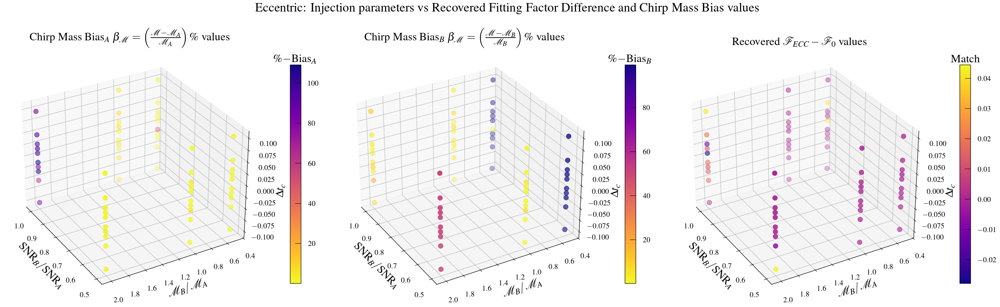

In [ ]:
fig, axes = plt.subplots(1, 3, figsize=(30, 10), subplot_kw={'projection': '3d'})

scatter1 = axes[0].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=bias_mchirp_a_ecc, edgecolor=None, cmap='plasma_r', s=100)
clb1 = fig.colorbar(scatter1, ax=axes[0], shrink=0.7, pad=0.1)
clb1.ax.set_title('$\\%-$Bias$_A$')
clb1.ax.ticklabel_format(useOffset=False, style='plain')

axes[0].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[0].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[0].set_zlabel('$\Delta t_c$')
axes[0].set_title('Chirp Mass Bias$_A$ $\\beta_{\\mathcal{M}}=\\left(\\frac{\\mathcal{M}-\\mathcal{M}_A}{\\mathcal{M}_A}\\right)\\%$ values', loc='center')
axes[0].ticklabel_format(useOffset=False, style='plain')
axes[0].azim = 150

scatter2 = axes[1].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=bias_mchirp_b_ecc, edgecolor=None, cmap='plasma_r', s=100)
clb2 = fig.colorbar(scatter2, ax=axes[1], shrink=0.7, pad=0.1)
clb2.ax.set_title('$\\%-$Bias$_B$')
clb2.ax.ticklabel_format(useOffset=False, style='plain')

axes[1].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[1].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[1].set_zlabel('$\Delta t_c$')
axes[1].set_title('Chirp Mass Bias$_B$ $\\beta_{\\mathcal{M}}=\\left(\\frac{\\mathcal{M}-\\mathcal{M}_B}{\\mathcal{M}_B}\\right)\\%$ values', loc='center')
axes[1].ticklabel_format(useOffset=False, style='plain')
axes[1].azim = 150

scatter3 = axes[2].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=match_ecc-match_ecc_0, edgecolor=None, cmap='plasma', s=100)
clb3 = fig.colorbar(scatter3, ax=axes[2], shrink=0.7, pad=0.1)
clb3.ax.set_title('Match')
clb3.ax.ticklabel_format(useOffset=False, style='plain')

axes[2].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[2].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[2].set_zlabel('$\Delta t_c$')
axes[2].set_title('Recovered $\mathcal{F}_{{ECC}}-\mathcal{F}_0$ values', loc='center')
axes[2].ticklabel_format(useOffset=False, style='plain')
axes[2].azim = 150

fig.suptitle('Eccentric: Injection parameters vs Recovered Fitting Factor Difference and Chirp Mass Bias values')
plt.tight_layout()
plt.savefig('../../output/pe_population_3G/match/ECC_DIFF_BIAS_MCHIRP(3D).png')
plt.show()

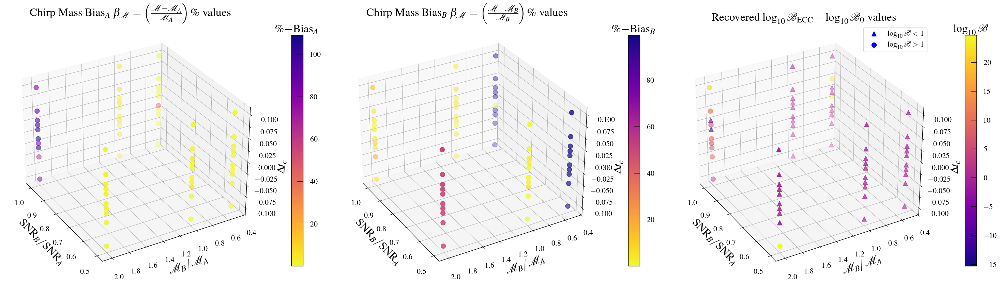

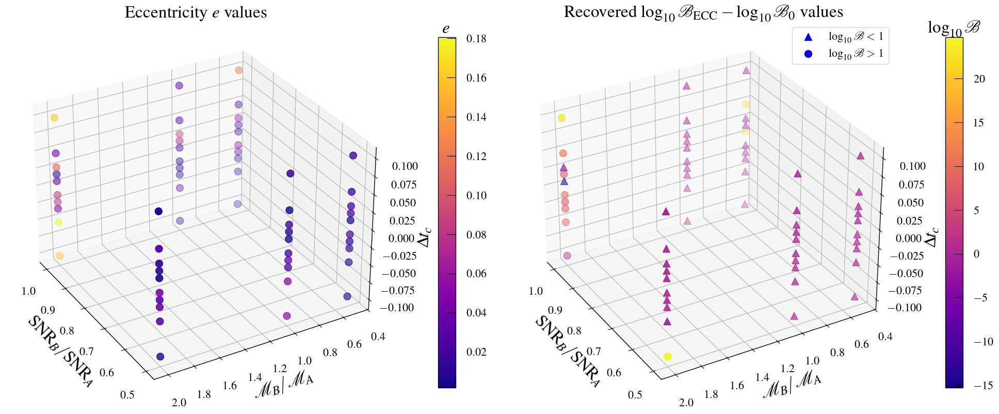

In [ ]:
fig, axes = plt.subplots(1, 3, figsize=(30, 10), subplot_kw={'projection': '3d'})

scatter1 = axes[0].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=bias_mchirp_a_ecc, edgecolor=None, cmap='plasma_r', s=100)
clb1 = fig.colorbar(scatter1, ax=axes[0], shrink=0.7, pad=0.1)
clb1.ax.set_title('$\\%-$Bias$_A$')
clb1.ax.ticklabel_format(useOffset=False, style='plain')

axes[0].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[0].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[0].set_zlabel('$\Delta t_c$')
axes[0].set_title('Chirp Mass Bias$_A$ $\\beta_{\\mathcal{M}}=\\left(\\frac{\\mathcal{M}-\\mathcal{M}_A}{\\mathcal{M}_A}\\right)\\%$ values', loc='center')
axes[0].ticklabel_format(useOffset=False, style='plain')
axes[0].azim = 150

scatter2 = axes[1].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=bias_mchirp_b_ecc, edgecolor=None, cmap='plasma_r', s=100)
clb2 = fig.colorbar(scatter2, ax=axes[1], shrink=0.7, pad=0.1)
clb2.ax.set_title('$\\%-$Bias$_B$')
clb2.ax.ticklabel_format(useOffset=False, style='plain')

axes[1].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[1].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[1].set_zlabel('$\Delta t_c$')
axes[1].set_title('Chirp Mass Bias$_B$ $\\beta_{\\mathcal{M}}=\\left(\\frac{\\mathcal{M}-\\mathcal{M}_B}{\\mathcal{M}_B}\\right)\\%$ values', loc='center')
axes[1].ticklabel_format(useOffset=False, style='plain')
axes[1].azim = 150

log_bayes_factor_ecc_diff = snr_a**2*(match_ecc**2-match_ecc_0**2)/2

diff_greater_1 = np.where(log_bayes_factor_ecc_diff > 1)
diff_0_1 = np.where(log_bayes_factor_ecc_diff <= 1)

scatter3 = axes[2].scatter(snr_b[diff_greater_1]/snr_a[diff_greater_1], mchirp_b[diff_greater_1]/mchirp_a[diff_greater_1], delta_tc[diff_greater_1], c=log_bayes_factor_ecc_diff[diff_greater_1], edgecolor=None, cmap='plasma', s=100, marker='o', vmin=np.min(log_bayes_factor_ecc_diff), vmax=np.max(log_bayes_factor_ecc_diff))
scatter5 = axes[2].scatter(snr_b[diff_0_1]/snr_a[diff_0_1], mchirp_b[diff_0_1]/mchirp_a[diff_0_1], delta_tc[diff_0_1], c=log_bayes_factor_ecc_diff[diff_0_1], edgecolor=None, cmap='plasma', s=100, marker='^', vmin=np.min(log_bayes_factor_ecc_diff), vmax=np.max(log_bayes_factor_ecc_diff))
clb3 = fig.colorbar(scatter3, ax=axes[2], shrink=0.7, pad=0.1)
clb3.ax.set_title('$\\log_{10}\\mathcal{B}$')
clb3.ax.ticklabel_format(useOffset=False, style='plain')

axes[2].scatter([], [], c='b', s=100, marker='^', label='$\\log_{10}\\mathcal{B} < 1$')
axes[2].scatter([], [], c='b', s=100, marker='o', label='$\\log_{10}\\mathcal{B} > 1$')
axes[2].legend(loc='upper right')

axes[2].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[2].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[2].set_zlabel('$\Delta t_c$')
axes[2].set_title('Recovered $\log_{10}\mathcal{B}_{\mathrm{ECC}}-\log_{10}\mathcal{B}_{0}$ values', loc='center')
axes[2].ticklabel_format(useOffset=False, style='plain')
axes[2].azim = 150

plt.tight_layout()
plt.savefig('../../output/pe_population_3G/match/EccentricFFPE.pdf', dpi=600, bbox_inches='tight')
plt.show()
plt.close()

fig, axes = plt.subplots(1, 2, figsize=(20, 10), subplot_kw={'projection': '3d'})

scatter1 = axes[0].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=e_ecc, edgecolor=None, cmap='plasma', s=100)
clb1 = fig.colorbar(scatter1, ax=axes[0], shrink=0.7, pad=0.1)
clb1.ax.set_title('$e$')

axes[0].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[0].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[0].set_zlabel('$\Delta t_c$')
axes[0].set_title('Eccentricity $e$ values', loc='center')
axes[0].ticklabel_format(useOffset=False, style='plain')
axes[0].azim = 150

scatter3 = axes[1].scatter(snr_b[diff_greater_1]/snr_a[diff_greater_1], mchirp_b[diff_greater_1]/mchirp_a[diff_greater_1], delta_tc[diff_greater_1], c=log_bayes_factor_ecc_diff[diff_greater_1], edgecolor=None, cmap='plasma', s=100, marker='o', vmin=np.min(log_bayes_factor_ecc_diff), vmax=np.max(log_bayes_factor_ecc_diff))
scatter5 = axes[1].scatter(snr_b[diff_0_1]/snr_a[diff_0_1], mchirp_b[diff_0_1]/mchirp_a[diff_0_1], delta_tc[diff_0_1], c=log_bayes_factor_ecc_diff[diff_0_1], edgecolor=None, cmap='plasma', s=100, marker='^', vmin=np.min(log_bayes_factor_ecc_diff), vmax=np.max(log_bayes_factor_ecc_diff))
clb3 = fig.colorbar(scatter3, ax=axes[1], shrink=0.7, pad=0.1)
clb3.ax.set_title('$\log_{10}\mathcal{B}$')
clb3.ax.ticklabel_format(useOffset=False, style='plain')

axes[1].scatter([], [], c='b', s=100, marker='^', label='$\\log_{10}\\mathcal{B} < 1$')
axes[1].scatter([], [], c='b', s=100, marker='o', label='$\\log_{10}\\mathcal{B} > 1$')
axes[1].legend(loc='upper right')

axes[1].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[1].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[1].set_zlabel('$\Delta t_c$')
axes[1].set_title('Recovered $\log_{10}\mathcal{B}_{\mathrm{ECC}}-\log_{10}\mathcal{B}_{0}$ values', loc='center')
axes[1].ticklabel_format(useOffset=False, style='plain')
axes[1].azim = 150

plt.tight_layout()
plt.savefig('../../output/pe_population_3G/match/EccentricFFParameters.pdf', dpi=600, bbox_inches='tight')
plt.show()
plt.close()

### Difference

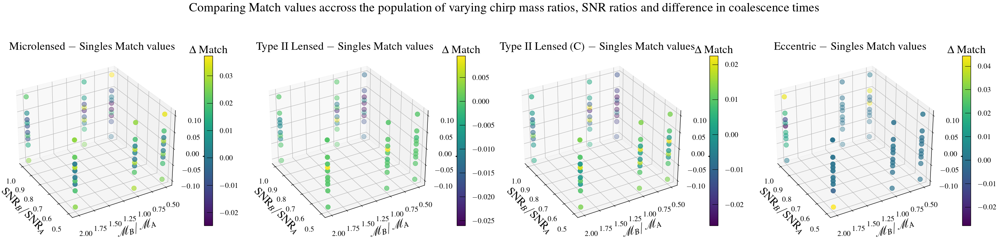

In [ ]:
fig, axes = plt.subplots(1, 4, figsize=(30, 8), subplot_kw={'projection': '3d'})

scatter1 = axes[0].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=match_ml-match, edgecolor=None, cmap='viridis', s=100)
clb1 = fig.colorbar(scatter1, ax=axes[0], shrink=0.7, pad=0.1)
clb1.ax.set_title('$\Delta$ Match')
clb1.ax.ticklabel_format(useOffset=False, style='plain')

axes[0].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[0].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[0].set_zlabel('$\Delta t_c$')
axes[0].set_title('Microlensed $-$ Singles Match values', loc='center')
axes[0].ticklabel_format(useOffset=False, style='plain')
axes[0].azim = 150

scatter2 = axes[1].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=match_ml2-match, edgecolor=None, cmap='viridis', s=100)
clb2 = fig.colorbar(scatter2, ax=axes[1], shrink=0.7, pad=0.1)
clb2.ax.set_title('$\\Delta$ Match')
clb2.ax.ticklabel_format(useOffset=False, style='plain')

axes[1].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[1].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[1].set_zlabel('$\Delta t_c$')
axes[1].set_title('Type II Lensed $-$ Singles Match values', loc='center')
axes[1].ticklabel_format(useOffset=False, style='plain')
axes[1].azim = 150

scatter3 = axes[2].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=match_ml2c-match, edgecolor=None, cmap='viridis', s=100)
clb3 = fig.colorbar(scatter3, ax=axes[2], shrink=0.7, pad=0.1)
clb3.ax.set_title('$\Delta$ Match')
clb3.ax.ticklabel_format(useOffset=False, style='plain')

axes[2].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[2].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[2].set_zlabel('$\Delta t_c$')
axes[2].set_title('Type II Lensed (C) $-$ Singles Match values', loc='center')
axes[2].ticklabel_format(useOffset=False, style='plain')
axes[2].azim = 150

scatter4 = axes[3].scatter(snr_b/snr_a, mchirp_b/mchirp_a, delta_tc, c=match_ecc-match_ecc_0, edgecolor=None, cmap='viridis', s=100)
clb4 = fig.colorbar(scatter4, ax=axes[3], shrink=0.7, pad=0.1)
clb4.ax.set_title('$\Delta$ Match')
clb4.ax.ticklabel_format(useOffset=False, style='plain')

axes[3].set_xlabel('$\mathrm{SNR}_B/\mathrm{SNR}_A$')
axes[3].set_ylabel('$\mathcal{M}_B/\mathcal{M}_A$')
axes[3].set_zlabel('$\Delta t_c$')
axes[3].set_title('Eccentric $-$ Singles Match values', loc='center')
axes[3].ticklabel_format(useOffset=False, style='plain')
axes[3].azim = 150

fig.suptitle('Comparing Match values accross the population of varying chirp mass ratios, SNR ratios and difference in coalescence times')
plt.tight_layout()
plt.savefig('../../output/pe_population_3G/match/DIFFERENCE(3D).png')
plt.show()

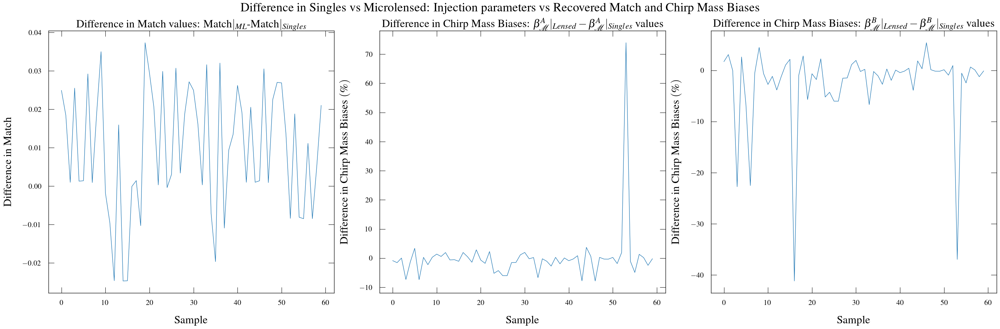

In [ ]:
fig, axes = plt.subplots(1, 3, figsize=(30, 10))

ax0 = axes[0].plot(match_ml-match)
axes[0].set_xlabel('Sample')
axes[0].set_ylabel('Difference in Match')
axes[0].ticklabel_format(useOffset=False, style='plain')
axes[0].set_title('Difference in Match values: Match$|_{ML}$-Match$|_{Singles}$', loc='center')

ax1 = axes[1].plot(bias_mchirp_a_ml-bias_mchirp_a)
axes[1].set_xlabel('Sample')
axes[1].set_ylabel('Difference in Chirp Mass Biases $($\\%$)$')
axes[1].ticklabel_format(useOffset=False, style='plain')
axes[1].set_title('Difference in Chirp Mass Biases: $\\beta^A_{\\mathcal{M}}|_{{Lensed}}-\\beta^A_{\\mathcal{M}}|_{{Singles}}$ values', loc='center')

ax2 = axes[2].plot(bias_mchirp_b_ml-bias_mchirp_b)
axes[2].set_xlabel('Sample')
axes[2].set_ylabel('Difference in Chirp Mass Biases $($\\%$)$')
axes[2].ticklabel_format(useOffset=False, style='plain')
axes[2].set_title('Difference in Chirp Mass Biases: $\\beta^B_{\\mathcal{M}}|_{{Lensed}}-\\beta^B_{\\mathcal{M}}|_{{Singles}}$ values', loc='center')

fig.suptitle('Difference in Singles vs Microlensed: Injection parameters vs Recovered Match and Chirp Mass Biases')
plt.tight_layout()
plt.savefig('../../output/pe_population_3G/match/LENS_DIFFERENCE(2D).png')
plt.show()

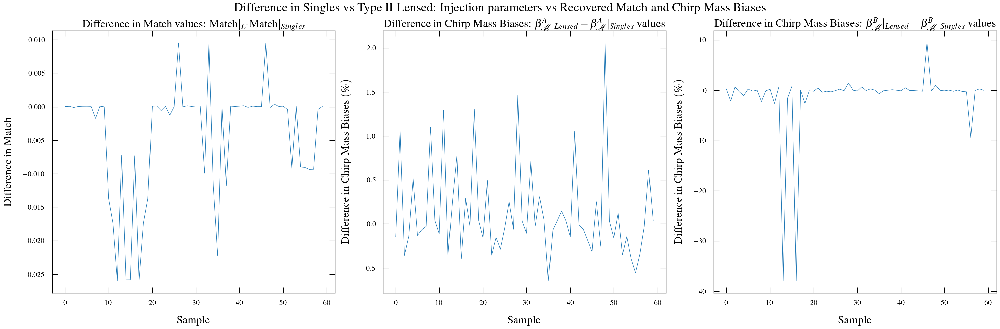

In [ ]:
fig, axes = plt.subplots(1, 3, figsize=(30, 10))

ax0 = axes[0].plot(match_ml2-match)
axes[0].set_xlabel('Sample')
axes[0].set_ylabel('Difference in Match')
axes[0].ticklabel_format(useOffset=False, style='plain')
axes[0].set_title('Difference in Match values: Match$|_{L}$-Match$|_{Singles}$', loc='center')

ax1 = axes[1].plot(bias_mchirp_a_ml2-bias_mchirp_a)
axes[1].set_xlabel('Sample')
axes[1].set_ylabel('Difference in Chirp Mass Biases $($\\%$)$')
axes[1].ticklabel_format(useOffset=False, style='plain')
axes[1].set_title('Difference in Chirp Mass Biases: $\\beta^A_{\\mathcal{M}}|_{{Lensed}}-\\beta^A_{\\mathcal{M}}|_{{Singles}}$ values', loc='center')

ax2 = axes[2].plot(bias_mchirp_b_ml2-bias_mchirp_b)
axes[2].set_xlabel('Sample')
axes[2].set_ylabel('Difference in Chirp Mass Biases $($\\%$)$')
axes[2].ticklabel_format(useOffset=False, style='plain')
axes[2].set_title('Difference in Chirp Mass Biases: $\\beta^B_{\\mathcal{M}}|_{{Lensed}}-\\beta^B_{\\mathcal{M}}|_{{Singles}}$ values', loc='center')

fig.suptitle('Difference in Singles vs Type II Lensed: Injection parameters vs Recovered Match and Chirp Mass Biases')
plt.tight_layout()
plt.savefig('../../output/pe_population_3G/match/SL2_DIFFERENCE(2D).png')
plt.show()

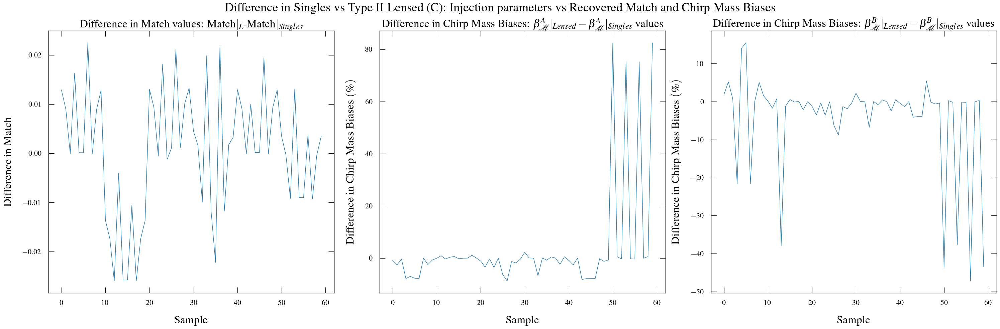

In [ ]:
fig, axes = plt.subplots(1, 3, figsize=(30, 10))

ax0 = axes[0].plot(match_ml2c-match)
axes[0].set_xlabel('Sample')
axes[0].set_ylabel('Difference in Match')
axes[0].ticklabel_format(useOffset=False, style='plain')
axes[0].set_title('Difference in Match values: Match$|_{L}$-Match$|_{Singles}$', loc='center')

ax1 = axes[1].plot(bias_mchirp_a_ml2c-bias_mchirp_a)
axes[1].set_xlabel('Sample')
axes[1].set_ylabel('Difference in Chirp Mass Biases $($\\%$)$')
axes[1].ticklabel_format(useOffset=False, style='plain')
axes[1].set_title('Difference in Chirp Mass Biases: $\\beta^A_{\\mathcal{M}}|_{{Lensed}}-\\beta^A_{\\mathcal{M}}|_{{Singles}}$ values', loc='center')

ax2 = axes[2].plot(bias_mchirp_b_ml2c-bias_mchirp_b)
axes[2].set_xlabel('Sample')
axes[2].set_ylabel('Difference in Chirp Mass Biases $($\\%$)$')
axes[2].ticklabel_format(useOffset=False, style='plain')
axes[2].set_title('Difference in Chirp Mass Biases: $\\beta^B_{\\mathcal{M}}|_{{Lensed}}-\\beta^B_{\\mathcal{M}}|_{{Singles}}$ values', loc='center')

fig.suptitle('Difference in Singles vs Type II Lensed (C): Injection parameters vs Recovered Match and Chirp Mass Biases')
plt.tight_layout()
plt.savefig('../../output/pe_population_3G/match/SL2C_DIFFERENCE(2D).png')
plt.show()

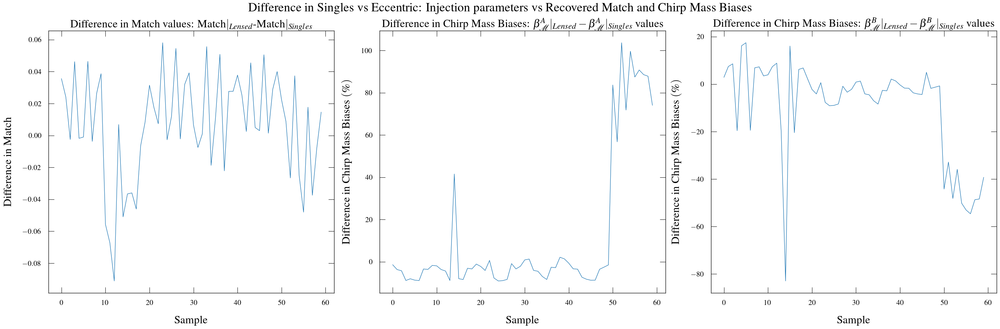

In [ ]:
fig, axes = plt.subplots(1, 3, figsize=(30, 10))

ax0 = axes[0].plot(match_ecc-match)
axes[0].set_xlabel('Sample')
axes[0].set_ylabel('Difference in Match')
axes[0].ticklabel_format(useOffset=False, style='plain')
axes[0].set_title('Difference in Match values: Match$|_{Lensed}$-Match$|_{Singles}$', loc='center')

ax1 = axes[1].plot(bias_mchirp_a_ecc-bias_mchirp_a)
axes[1].set_xlabel('Sample')
axes[1].set_ylabel('Difference in Chirp Mass Biases $($\\%$)$')
axes[1].ticklabel_format(useOffset=False, style='plain')
axes[1].set_title('Difference in Chirp Mass Biases: $\\beta^A_{\\mathcal{M}}|_{{Lensed}}-\\beta^A_{\\mathcal{M}}|_{{Singles}}$ values', loc='center')

ax2 = axes[2].plot(bias_mchirp_b_ecc-bias_mchirp_b)
axes[2].set_xlabel('Sample')
axes[2].set_ylabel('Difference in Chirp Mass Biases $($\\%$)$')
axes[2].ticklabel_format(useOffset=False, style='plain')
axes[2].set_title('Difference in Chirp Mass Biases: $\\beta^B_{\\mathcal{M}}|_{{Lensed}}-\\beta^B_{\\mathcal{M}}|_{{Singles}}$ values', loc='center')

fig.suptitle('Difference in Singles vs Eccentric: Injection parameters vs Recovered Match and Chirp Mass Biases')
plt.tight_layout()
plt.savefig('../../output/pe_population_3G/match/ECC_DIFFERENCE(2D).png')
plt.show()